In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.metrics import confusion_matrix, accuracy_score,precision_score, recall_score, f1_score, precision_recall_curve, matthews_corrcoef
from Bio.SeqUtils.ProtParam import ProteinAnalysis
from Bio.SeqUtils import ProtParamData
from sklearn.preprocessing import MinMaxScaler
from sklearn.svm import SVC


# 2. DATA PREPARATION

In [2]:
def extract_id(fasta_file):
    ''' It takes in input a fasta file and returns a list where every element is the accession number'''
    
    ids= []
    with open (fasta_file, "r") as inpf:
        for line in inpf:
            if line.startswith(">"):
                line = line.strip()
                ids.append(line[1:])
    return ids

In [3]:
#Read the tsv and create the corresponding dataframe with an header

pos = pd.read_csv('positives.tsv', sep='\t')
neg = pd.read_csv('negatives.tsv', sep='\t')
header_pos = ["Accession", "Organism", "Kingdom", "Length", "Cleavage"]
header_neg = ["Accession", "Organism", "Kingdom", "Length", "Transmembrane"]

pos.columns = header_pos
neg.columns = header_neg

In [4]:
def filter_id(unfiltered_df,repr_fasta_file, tsv_name):
    '''It takes in input a dataframe, a fasta file with representative sequences and the name of the final tsv file that we want create. 
    It returns a filtered dataframe containing only the representative sequences'''
    
    selected_ids = extract_id(repr_fasta_file)
    filtered_df_list=[]
    for id in selected_ids:
        new_df = unfiltered_df.query('Accession == "%s"' %id) #The result is a new dataframe for each selected id
        # Append the filtered DataFrame to the list
        filtered_df_list.append(new_df)
    selected_df = pd.concat(filtered_df_list, ignore_index=True)
    
    selected_df.to_csv(tsv_name, sep='\t', header=True, index=False)
    return selected_df

In [5]:
selected_pos_df = filter_id(pos, "pos_cluster-results_rep_seq.fasta", "filtered_repr_pos.tsv")
selected_neg_df = filter_id(neg, "neg_cluster-results_rep_seq.fasta", "filtered_repr_neg.tsv")

selected_pos_df["Type"] = "+"
selected_neg_df["Type"] = "-"

In [6]:
# Shuffle and split into 80% training and 20% benchmark
def split_df(df, percentage):
    '''  It takes in a dataframe and a decimal number (percentage).  It returns 2 dataframes divided depending on the percentage.'''
    
    # Sample the specified fraction with a fixed random state
    training_df = df.sample(frac=percentage).reset_index(drop=True)
    
    # Select the remaining rows for the benchmark set
    benchmark_df = df[~df.index.isin(training_df.index)].reset_index(drop=True)
    
    return training_df, benchmark_df


In [7]:
pos_training_df, pos_benchmark_df = split_df(selected_pos_df, 0.8)
neg_training_df, neg_benchmark_df = split_df(selected_neg_df, 0.8)

In [8]:
def create_folds(df, num_fold):
    ''' It takes in input a dataframe and the number of desired folds, adds a new column "Fold" assigning a fold to each entry '''
    
    repetitions = (len(df)//num_fold) +1
    l = list(range(num_fold))
    new_col = l * repetitions 
    
    df["Fold"] = new_col[:len(df)]
    return df

In [9]:
create_folds(pos_training_df,5)
create_folds(neg_training_df,5)

,Accession,Organism,Kingdom,Length,Transmembrane,Type,Fold
0,Q9JJN6,Mus musculus,Metazoa,81,False,-,0
1,P03877,Saccharomyces cerevisiae (strain ATCC 204508 /...,Fungi,415,True,-,1
2,Q9LW26,Arabidopsis thaliana,Viridiplantae,701,False,-,2
3,O15014,Homo sapiens,Metazoa,1411,False,-,3
4,O44548,Caenorhabditis elegans,Metazoa,877,False,-,4
...,...,...,...,...,...,...,...
7026,Q8IWA0,Homo sapiens,Metazoa,830,False,-,1
7027,Q9VKB9,Drosophila melanogaster,Metazoa,1341,False,-,2
7028,Q15067,Homo sapiens,Metazoa,660,False,-,3
7029,Q9HA38,Homo sapiens,Metazoa,289,False,-,4


In [10]:
pos_training_df.tail()

,Accession,Organism,Kingdom,Length,Cleavage,Type,Fold
863,Q9H293,Homo sapiens,Metazoa,177,32,+,3
864,Q27441,Aplysia californica,Metazoa,92,21,+,4
865,Q5AMT2,Candida albicans (strain SC5314 / ATCC MYA-2876),Fungi,308,18,+,0
866,P82143,Gloydius brevicaudus siniticus,Metazoa,200,19,+,1
867,Q02083,Homo sapiens,Metazoa,359,28,+,2


In [11]:
neg_training_df.tail()

,Accession,Organism,Kingdom,Length,Transmembrane,Type,Fold
7026,Q8IWA0,Homo sapiens,Metazoa,830,False,-,1
7027,Q9VKB9,Drosophila melanogaster,Metazoa,1341,False,-,2
7028,Q15067,Homo sapiens,Metazoa,660,False,-,3
7029,Q9HA38,Homo sapiens,Metazoa,289,False,-,4
7030,P82094,Homo sapiens,Metazoa,1093,False,-,0


In [12]:
# Write neg_training_df and pos_training_df to TSV files
neg_training_df.to_csv('neg_training.tsv', sep='\t', index=False)
pos_training_df.to_csv('pos_training.tsv', sep='\t', index=False)
pos_benchmark_df.to_csv('pos_benchmark.tsv', sep='\t', index=False)
neg_benchmark_df.to_csv('neg_benchmark.tsv', sep='\t', index=False)

In [13]:
training_df = pd.concat([pos_training_df, neg_training_df])
benchmark_df = pd.concat([pos_benchmark_df, neg_benchmark_df])

In [14]:
training_df.to_csv('training.tsv',sep='\t', index=False)
benchmark_df.to_csv('benchmark.tsv', sep='\t',index=False)

In [15]:
# Sample data
total_training_set_size = len(training_df)
total_benchmark_set_size = len(benchmark_df)
positive_training_set_size = len(pos_training_df)
negative_training_set_size = len(neg_training_df)
total_positive_benchmark_size = len(pos_benchmark_df)
total_negative_benchmark_size = len(neg_benchmark_df)

# Create a summary DataFrame
total_sample_size = {
    "Dataset": ["Training Set", "Benchmark Set"],
    "Total Samples": [total_training_set_size, total_benchmark_set_size],
    "Positive Samples": [positive_training_set_size, total_positive_benchmark_size],
    "Negative Samples": [negative_training_set_size, total_negative_benchmark_size],
    "Positive Proportion": [positive_training_set_size / total_training_set_size * 100,
                           total_positive_benchmark_size / total_benchmark_set_size * 100],
    "Negative Proportion": [negative_training_set_size / total_training_set_size * 100,
                           total_negative_benchmark_size / total_benchmark_set_size * 100]
}

total_sample_size_df = pd.DataFrame(total_sample_size)

In [16]:
total_sample_size_df

,Dataset,Total Samples,Positive Samples,Negative Samples,Positive Proportion,Negative Proportion
0,Training Set,7899,868,7031,10.988733,89.011267
1,Benchmark Set,1975,217,1758,10.987342,89.012658


In [123]:
training_df.groupby("Fold").count()

,Accession,Organism,Kingdom,Length,Cleavage,Type,Transmembrane
Fold,,,,,,,
0,1581,1581,1581,1581,174,1581,1407
1,1580,1580,1580,1580,174,1580,1406
2,1580,1580,1580,1580,174,1580,1406
3,1579,1579,1579,1579,173,1579,1406
4,1579,1579,1579,1579,173,1579,1406


# 3. DATA ANALYSIS 

### 3.1 The distribution of protein lengths comparing positive and negative sequences
We have to normalize the data such that the height of each bar is not corresponding to the raw count but to the relative frequency of data in that bin.

Should we remove the outlier protein very huge (200000 residues). Should we remove this protein?
Our problem is very local and it's about detecting a sequence in the N-terminus. 
For visualziing we can use the boxplot that will be the highlitht the outlier

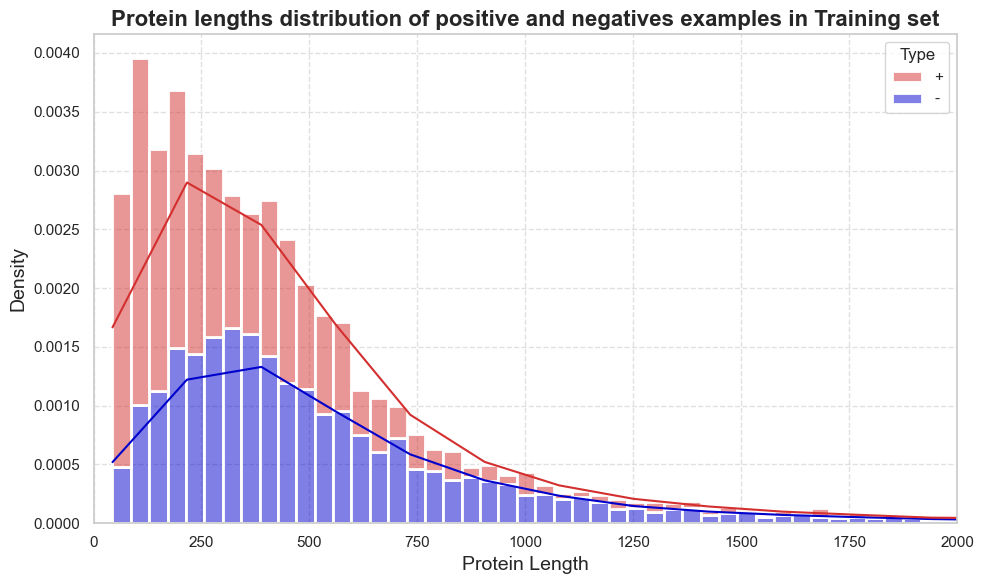

In [134]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define a new color palette for "+" and "-" types with stronger, more vibrant colors
custom_palette = {"+": "#D32F2F", "-": "#0000CD"}  # OrangeRed for "+" and MediumBlue for "-"

# Create the histogram for the Training set with contour lines and KDE
fig, ax = plt.subplots(figsize=(10, 6))  # Increase figure size for better visibility

sns.histplot(
    training_df, 
    x="Length", 
    hue="Type", 
    stat="density", 
    common_norm=False, 
    ax=ax, 
    kde=True, 
    palette=custom_palette, 
    linewidth=2,  # Add line width to KDE curve for visibility
    multiple="stack"  # Stack the distributions for better comparison
)

# Set plot limits and title with improved font properties
ax.set(xlim=(0, 2000))
ax.set_title("Protein lengths distribution of positive and negatives examples in Training set", 
             fontsize=16, 
             fontweight='bold')

# Add grid lines to improve readability
ax.grid(True, linestyle='--', alpha=0.6)

# Set x-axis label with better font properties
ax.set_xlabel("Protein Length", fontsize=14)
ax.set_ylabel("Density", fontsize=14)

plt.tight_layout()  # Adjust layout for better spacing
plt.show()


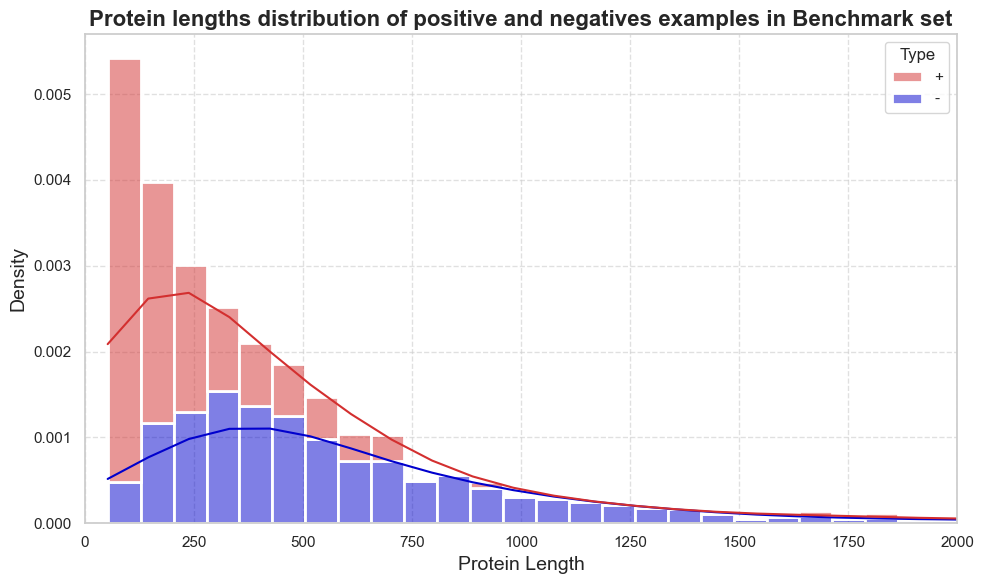

In [133]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define a new color palette for "+" and "-" types with brighter colors
custom_palette = {"+": "#D32F2F", "-": "#0000CD"}  # OrangeRed for "+" and MediumBlue for "-"

# Create the histogram for the Benchmark set with contour lines and KDE
fig, ax = plt.subplots(figsize=(10, 6))  # Increase figure size for better visibility

sns.histplot(
    benchmark_df, 
    x="Length", 
    hue="Type", 
    stat="density", 
    common_norm=False, 
    ax=ax, 
    kde=True, 
    palette=custom_palette, 
    linewidth=2,  # Add line width to KDE curve for visibility
    multiple="stack"  # Stack the distributions for better comparison
)

# Set plot limits and title with improved font properties
ax.set(xlim=(0, 2000))
ax.set_title("Protein lengths distribution of positive and negatives examples in Benchmark set", 
             fontsize=16, 
             fontweight='bold')

# Add grid lines to improve readability
ax.grid(True, linestyle='--', alpha=0.6)

# Set x-axis label with better font properties
ax.set_xlabel("Protein Length", fontsize=14)
ax.set_ylabel("Density", fontsize=14)

plt.tight_layout()  # Adjust layout for better spacing
plt.show()


### 3.2 The distribution of SP lengths

<Figure size 800x600 with 0 Axes>

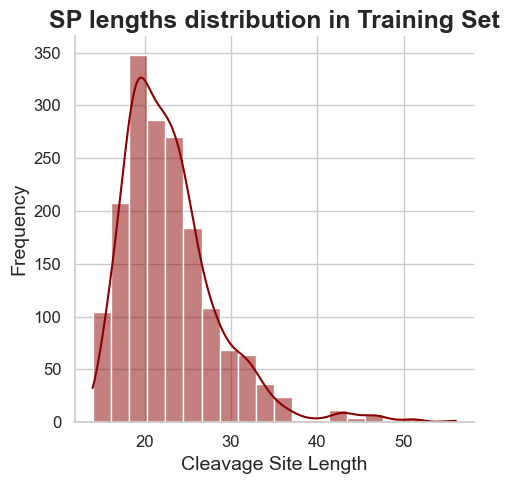

In [126]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot with improved aesthetics and dark red color
sns.set(style="whitegrid")  # Set a clean background style
plt.figure(figsize=(8, 6))  # Adjust figure size for better readability

# Dark red color and bins adjustment
sns.displot(training_df, x="Cleavage", kde=True, color="darkred", bins=20)

# Set title and labels with increased font size and bold style
plt.title("SP lengths distribution in Training Set", fontsize=18, fontweight='bold')
plt.xlabel("Cleavage Site Length", fontsize=14)
plt.ylabel("Frequency", fontsize=14)

# Adjust font size for axis ticks
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Adjust layout to prevent clipping
plt.tight_layout()
plt.show()


<Figure size 800x600 with 0 Axes>

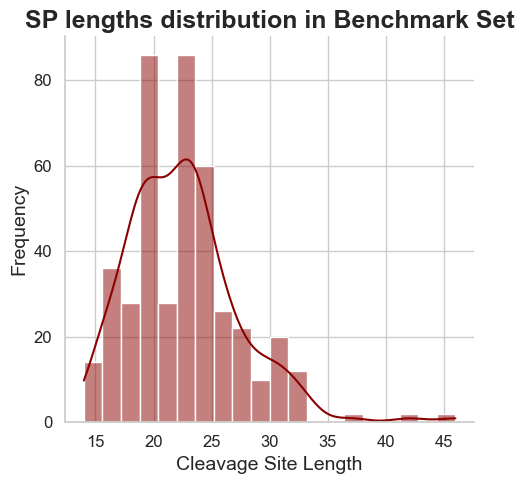

In [125]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot with improved aesthetics and dark red color
sns.set(style="whitegrid")  # Set a clean background style
plt.figure(figsize=(8, 6))  # Adjust figure size for better readability

# Dark red color and bins adjustment
sns.displot(benchmark_df, x="Cleavage", kde=True, color="darkred", bins=20)

# Set title and labels with increased font size and bold style
plt.title("SP lengths distribution in Benchmark Set", fontsize=18, fontweight='bold')
plt.xlabel("Cleavage Site Length", fontsize=14)
plt.ylabel("Frequency", fontsize=14)

# Adjust font size for axis ticks
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Adjust layout to prevent clipping
plt.tight_layout()
plt.show()


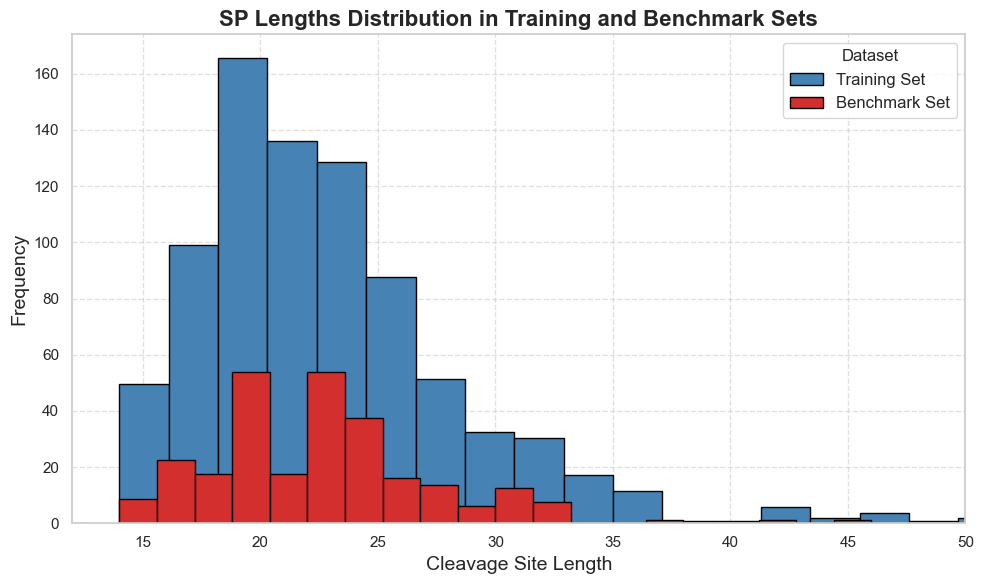

In [181]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the style and figure size for better readability
sns.set(style="whitegrid")  # Clean background style
fig, ax = plt.subplots(figsize=(10, 6))  # Adjust figure size for better visibility

# Define a color palette with lighter colors for both datasets
custom_palette = {"Benchmark Set": "#D32F2F", "Training Set": "#4682B4"}  # Light Blue for Training Set and Red for Benchmark Set

# Plot the Training Set distribution with solid bars (primary, on top)
sns.histplot(
    training_df, 
    x="Cleavage",  # Replace with the correct column name if needed
    color="#4682B4",  # Light Blue for Training Set
    bins=20, 
    label="Training Set", 
    stat="frequency",  # Use frequency instead of density
    common_norm=False,  # Separate normalization for each distribution
    alpha=1.0,  # Full opacity (no transparency)
    edgecolor="black",  # Black contour around the bars
    linewidth=1,  # Line width for the black contour
    ax=ax  # Ensure it plots on the same axes
)

# Plot the Benchmark Set distribution with solid bars (secondary, in the background)
sns.histplot(
    benchmark_df, 
    x="Cleavage",  # Replace with the correct column name if needed
    color="#D32F2F",  # Red for Benchmark Set
    bins=20, 
    label="Benchmark Set", 
    stat="frequency",  # Use frequency instead of density
    common_norm=False,  # Separate normalization for each distribution
    alpha=1.0,  # Full opacity (no transparency)
    edgecolor="black",  # Black contour around the bars
    linewidth=1,  # Line width for the black contour
    ax=ax  # Ensure it plots on the same axes
)

# Set plot limits, title, and labels
ax.set_title("SP Lengths Distribution in Training and Benchmark Sets", fontsize=16, fontweight='bold')
ax.set_xlabel("Cleavage Site Length", fontsize=14)
ax.set_ylabel("Frequency", fontsize=14)

# Add a legend
ax.legend(title="Dataset", fontsize=12)

# Add gridlines for better readability
ax.grid(True, linestyle='--', alpha=0.6)

# Set x-axis limits (from 12 to 50 as per the request)
ax.set(xlim=(12, 50))

# Adjust layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


### 3.3 Comparative amino-acid composition of SPs against some background distribution e.g. amino acid composition of SwissProt available at https://web.expasy.org/docs/relnotes/relstat.html
Display AA compositions of SP sequences and SwissProt using a combined barplot as shown before

### 3.4 Taxonomic classification (at kingdom and species levels) ○ Use either a pie chart or a barplot


Text(0.5, 1.0, 'Distribution of Kingdoms in the Training set')

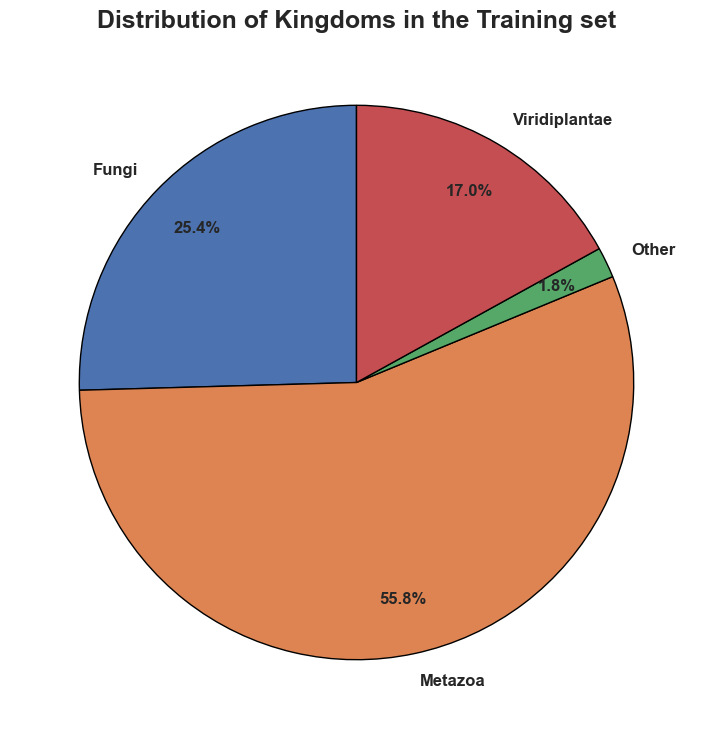

In [153]:
values = training_df.groupby(by="Kingdom").count()["Accession"]
labels = training_df.groupby(by="Kingdom").count().index

plt.figure(figsize=(9, 9))  # Increase the size of the figure (width, height)
colors = sns.color_palette("deep", n_colors=8)


plt.pie(values, 
        labels=labels, 
        autopct='%1.1f%%', 
        colors=colors,  # Apply the color palette
        textprops={'fontsize': 12, 'fontweight': 'bold'},  # Adjust font size if needed
        labeldistance=1.1,  # Distance of labels from the center
        pctdistance=0.8,   # Distance of percentage text from the center
        wedgeprops={'linewidth': 1, 'edgecolor': 'black'},  # Adding borders to the slices
        startangle=90)      # Start angle for better orientation of slices

plt.title('Distribution of Kingdoms in the Training set', fontsize=18, fontweight='bold')

Text(0.5, 1.0, 'Distribution of Kingdoms in the Benchmark set')

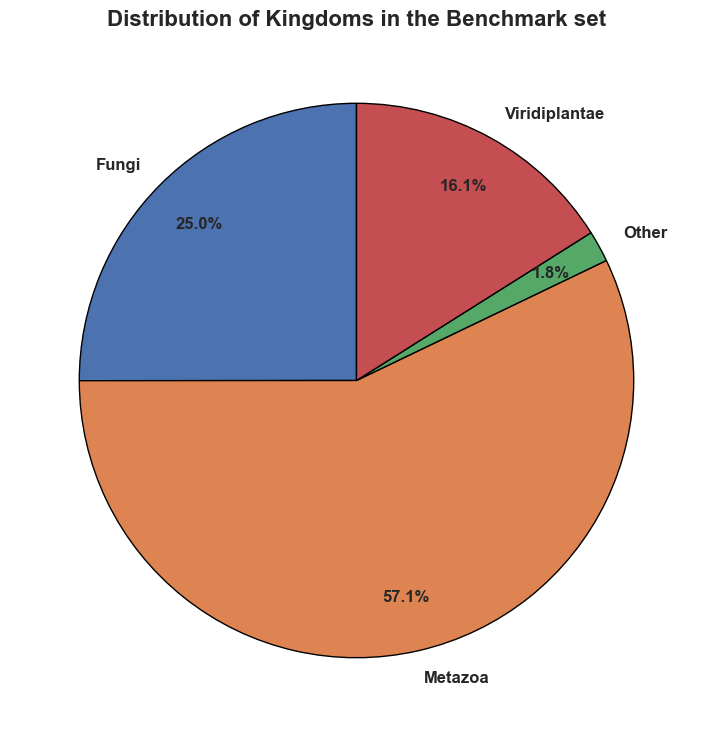

In [155]:
values = benchmark_df.groupby(by="Kingdom").count()["Accession"]
labels = benchmark_df.groupby(by="Kingdom").count().index

plt.figure(figsize=(9, 9))  # Increase the size of the figure (width, height)
colors = sns.color_palette("deep", n_colors=8)


plt.pie(values, 
        labels=labels, 
        autopct='%1.1f%%', 
        colors=colors,  # Apply the color palette
        textprops={'fontsize': 12, 'fontweight': 'bold'},  # Adjust font size if needed
        labeldistance=1.1,  # Distance of labels from the center
        pctdistance=0.8,   # Distance of percentage text from the center
        wedgeprops={'linewidth': 1, 'edgecolor': 'black'},  # Adding borders to the slices
        startangle=90)      # Start angle for better orientation of slices

plt.title('Distribution of Kingdoms in the Benchmark set', fontsize=16, fontweight='bold')

In [23]:
top_7_training = training_df.groupby(by="Organism").count().sort_values(by="Accession", ascending=False).head(7)
other_training = training_df.groupby(by="Organism").count().sort_values(by="Accession", ascending=False).tail(-7).sum()

top_7_training.loc["Other"] = other_training #Add to the dataframe a new row called Other

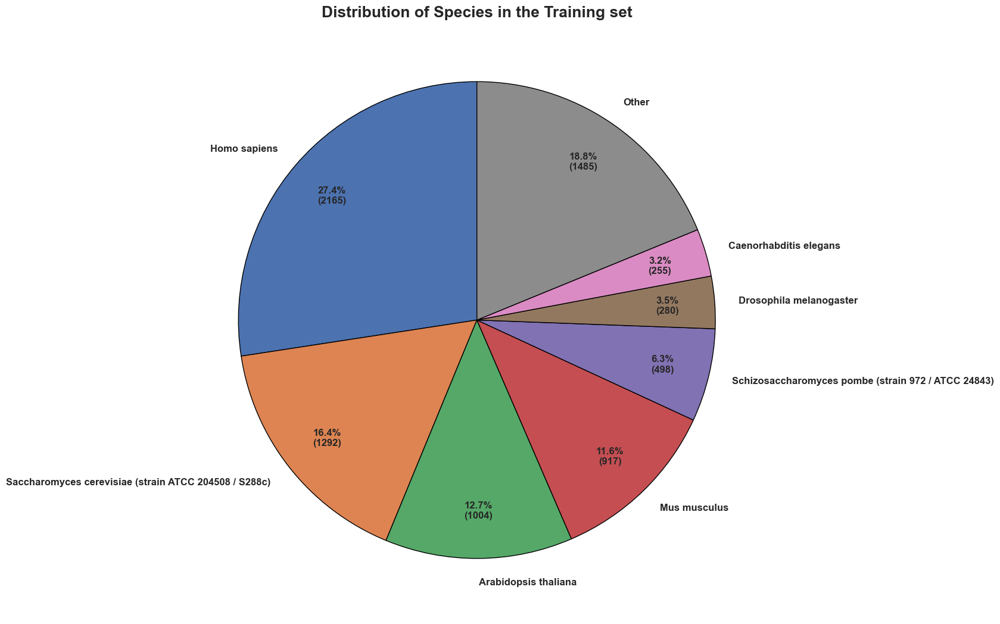

In [157]:
plt.figure(figsize=(13, 13))  # Increase the size of the figure (width, height)


colors = sns.color_palette("deep", n_colors=8)

import matplotlib.pyplot as plt

# Custom autopct function to display both percentage and raw count
def autopct_with_count(pct, values):
    absolute = int(pct/100. * sum(values))
    return f'{pct:.1f}%\n({absolute})'

# Assuming `top_7_training["Accession"]` contains the raw counts
values = top_7_training["Accession"]

# Creating the pie chart with label lines
plt.pie(values, 
        labels=top_7_training.index, 
        autopct=lambda pct: autopct_with_count(pct, values),  # Use the custom function
        colors=colors,  # Apply the color palette
        textprops={'fontsize': 12, 'fontweight': 'bold'},  # Adjust font size if needed
        labeldistance=1.1,  # Distance of labels from the center
        pctdistance=0.8,   # Distance of percentage text from the center
        wedgeprops={'linewidth': 1, 'edgecolor': 'black'},  # Adding borders to the slices
        startangle=90)      # Start angle for better orientation of slices

# Set the title
plt.title('Distribution of Species in the Training set', fontsize=19, fontweight='bold')

# Show the pie chart
plt.show()

In [25]:
# Prepare the data
top_7_benchmark = benchmark_df.groupby(by="Organism").count().sort_values(by="Accession", ascending=False).head(7)
other_benchmark = benchmark_df.groupby(by="Organism").count().sort_values(by="Accession", ascending=False).tail(-7).sum()

top_7_benchmark.loc["Other"] = other_benchmark  # Add to the dataframe a new row called Other

Text(0.5, 1.0, 'Distribution of Species in the Benchmark set')

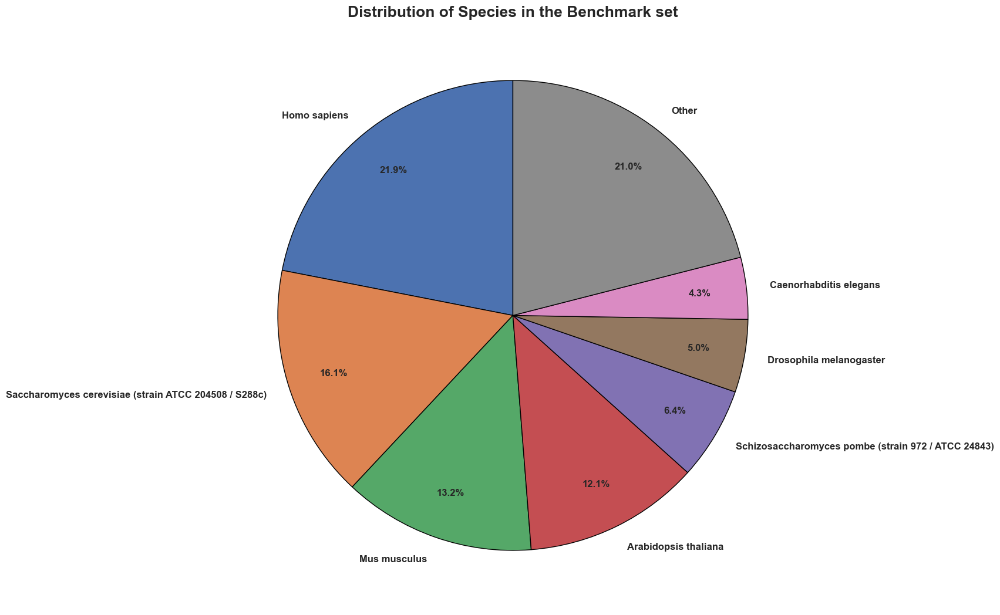

In [159]:
# Create a larger figure
plt.figure(figsize=(13, 13))  # Increase the size of the figure (width, height)

# Get a color palette from seaborn
colors = sns.color_palette("deep", n_colors=8)

# Creating the pie chart with label lines
plt.pie(top_7_benchmark["Accession"], 
        labels=top_7_benchmark.index, 
        autopct='%1.1f%%', 
        colors=colors,  # Apply the color palette
        textprops={'fontsize': 12, 'fontweight': 'bold'},  # Bold font for the percentages
        labeldistance=1.1,  # Distance of labels from the center
        pctdistance=0.8,    # Distance of percentage text from the center
        wedgeprops={'linewidth': 1, 'edgecolor': 'black'},  # Adding borders to the slices
        startangle=90)      # Start angle for better orientation of slices

# Set the title with a larger and bold font
plt.title('Distribution of Species in the Benchmark set', fontsize=19, fontweight='bold')


In [27]:
def parse_fasta (fasta_file):
    with open(fasta_file, "r") as fasta:
        fasta_dict = {}  # Dictionary to store the sequences
        current_id = ""   # Variable to hold the current sequence ID
        current_seq = ""  # Variable to accumulate the current sequence
        
        for line in fasta:
            line = line.strip()  # Remove leading/trailing whitespace
            if line.startswith(">"):  # This line is a sequence ID
                # If current_id is not empty, it means we have read a sequence and need to store it
                if current_id:
                    fasta_dict[current_id] = current_seq  # Save the current sequence for the previous ID
                # Start a new sequence with the current ID
                current_id = line[1:]  # Remove '>' from the ID
                current_seq = ""  # Reset current_seq for the new sequence
            else:
                # Accumulate sequence lines
                current_seq += line

        # After the loop, add the last sequence to the dictionary
        if current_id:
            fasta_dict[current_id] = current_seq

    return fasta_dict

In [28]:
total_pos_fasta = parse_fasta("pos_cluster-results_rep_seq.fasta")
total_neg_fasta = parse_fasta("neg_cluster-results_rep_seq.fasta")

### 3.4 COMPOSITION FREQUENCY

In [29]:

swiss_prot_freq= {"A": 8.25, "Q": 3.93,  "L": 9.64, "S": 6.65,

   "R": 5.52,   "E": 6.71,   "K": 5.80,   "T": 5.36,

   "N": 4.06,   "G": 7.07,   "M": 2.41,   "W": 1.10,

   "D": 5.46,   "H": 2.27,   "F": 3.86,   "Y": 2.92,

   "C": 1.38,   "I": 5.91,   "P": 4.74,   "V": 6.85}

In [30]:
def get_seq(dict_fasta:dict, id:str, start, end):
    seq = dict_fasta[id]
    return seq[start:end]

In [31]:
pos_training_df.head()

,Accession,Organism,Kingdom,Length,Cleavage,Type,Fold
0,C4NZN9,Hyas araneus,Metazoa,131,16,+,0
1,O14412,Orpinomyces sp. (strain PC-2),Fungi,245,29,+,1
2,P55847,Penaeus japonicus,Metazoa,105,28,+,2
3,Q02747,Homo sapiens,Metazoa,115,21,+,3
4,Q7KRU8,Drosophila melanogaster,Metazoa,205,19,+,4


In [32]:
with open ("logo_seq_train.txt", "w") as logo, open("frequency_train.txt", "w") as frequency:
        for index, row in pos_training_df.iterrows():
                code = row["Accession"] 
                site = row ["Cleavage"]
                s,e = site-13,site+2
                logo_seq = get_seq(total_pos_fasta, code,s,e)
                freq_seq = get_seq(total_pos_fasta,code, 0, site)
                logo.write(logo_seq + "\n")
                frequency.write(freq_seq + "\n")

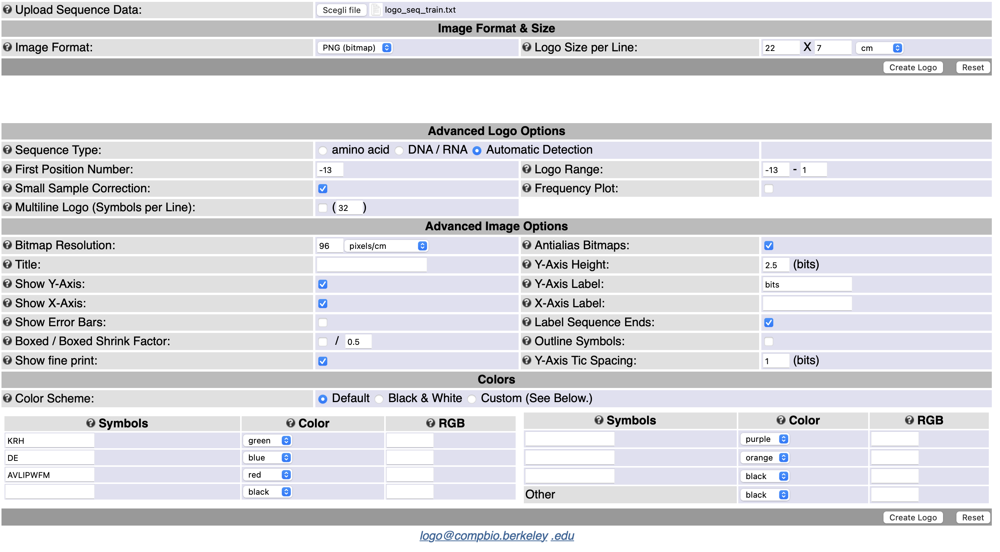

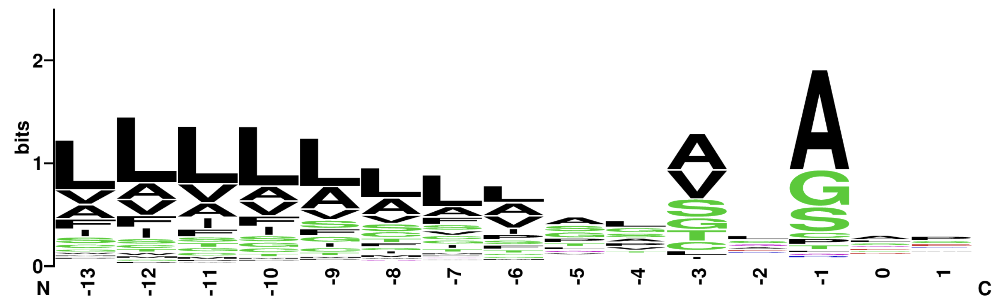

In [33]:
with open ("logo_seq_benchmark.txt", "w") as logo, open("frequency_benchmark.txt", "w") as frequency:
        for index, row in pos_benchmark_df.iterrows():
                code = row["Accession"] 
                site = row ["Cleavage"]
                s,e = site-13,site+2
                logo_seq = get_seq(total_pos_fasta, code,s,e)
                freq_seq = get_seq(total_pos_fasta,code, 0, site)
                logo.write(logo_seq + "\n")
                frequency.write(freq_seq + "\n")

In [34]:
training_freq={}
with open("frequency_train.txt", "r") as inpf:
    for line in inpf:
        line=line.strip()
        for ch in line:
            training_freq[ch] = training_freq.get(ch,0) +1

In [35]:
def get_dict_frequency(seq_file):
    dict_freq={}
    with open(seq_file, "r") as inpf:
        for line in inpf:
            line=line.strip()
            for ch in line:
                dict_freq[ch] = dict_freq.get(ch,0) +1
    
    list_values = (list(dict_freq.values()))
    
    total_sum = sum(list_values)
    normalized_dict = {key: values/total_sum *100  for key,values in dict_freq.items()}
    
    #freq_df = pd.DataFrame(list(normalized_dict.items()), columns = ["Aminoacid", "Raw count"])
    freq_df = pd.DataFrame (list(normalized_dict.items()), columns = ["Aminoacid", "Frequency"])
    return freq_df

In [36]:
print(training_freq)

{'M': 1262, 'R': 657, 'V': 1634, 'L': 4371, 'I': 893, 'S': 1476, 'A': 2872, 'H': 235, 'K': 442, 'G': 1215, 'T': 880, 'P': 837, 'Y': 197, 'W': 341, 'F': 986, 'D': 176, 'N': 200, 'C': 589, 'Q': 420, 'E': 268, 'X': 10}


In [37]:
print(swiss_prot_freq)

{'A': 8.25, 'Q': 3.93, 'L': 9.64, 'S': 6.65, 'R': 5.52, 'E': 6.71, 'K': 5.8, 'T': 5.36, 'N': 4.06, 'G': 7.07, 'M': 2.41, 'W': 1.1, 'D': 5.46, 'H': 2.27, 'F': 3.86, 'Y': 2.92, 'C': 1.38, 'I': 5.91, 'P': 4.74, 'V': 6.85}


In [38]:
#Create a new dataframe with aminoacids in rows then columns:
# - frequency in training
# - frequency in benchamark
# - frequency in swiss prot


In [39]:
training_freq_df = get_dict_frequency("frequency_train.txt")
training_freq_df.head(20)

,Aminoacid,Frequency
0,M,6.322329
1,R,3.291418
2,V,8.185963
3,L,21.897701
4,I,4.473724
5,S,7.394419
6,A,14.388057
7,H,1.177296
8,K,2.214318
9,G,6.086869


In [40]:
training_freq_df = training_freq_df[training_freq_df['Aminoacid'] != 'X']
sorted_training_freq_df = training_freq_df.sort_values("Aminoacid")
sorted_training_freq_df

,Aminoacid,Frequency
6,A,14.388057
17,C,2.950754
15,D,0.881719
19,E,1.342618
14,F,4.939632
9,G,6.086869
7,H,1.177296
4,I,4.473724
8,K,2.214318
3,L,21.897701


In [41]:
benchmark_freq_df = get_dict_frequency("frequency_benchmark.txt")
benchmark_freq_df = benchmark_freq_df[benchmark_freq_df['Aminoacid'] != 'X']
sorted_benchmark_freq_df = benchmark_freq_df.sort_values("Aminoacid")
sorted_benchmark_freq_df

,Aminoacid,Frequency
2,A,15.181855
3,C,2.574581
17,D,1.021659
18,E,1.552922
14,F,5.598692
8,G,5.067430
16,H,1.082959
4,I,5.087863
12,K,2.635881
6,L,20.576216


In [42]:
swiss_prot_freq = pd.Series(swiss_prot_freq)
sorted_swiss_prot_freq = swiss_prot_freq.sort_index()
sorted_swiss_prot_freq


A    8.25
C    1.38
D    5.46
E    6.71
F    3.86
G    7.07
H    2.27
I    5.91
K    5.80
L    9.64
M    2.41
N    4.06
P    4.74
Q    3.93
R    5.52
S    6.65
T    5.36
V    6.85
W    1.10
Y    2.92
dtype: float64

In [43]:
#Creazione del DataFrame totale
frequency_df = pd.DataFrame({
    "Training frequency": sorted_training_freq_df["Frequency"].values,
    "Benchmark frequency": sorted_benchmark_freq_df["Frequency"].values,  
    "Swiss prot frequency": sorted_swiss_prot_freq.values
}, index=sorted_training_freq_df['Aminoacid'])

In [44]:
frequency_df.head(20)

,Training frequency,Benchmark frequency,Swiss prot frequency
Aminoacid,,,
A,14.388057,15.181855,8.25
C,2.950754,2.574581,1.38
D,0.881719,1.021659,5.46
E,1.342618,1.552922,6.71
F,4.939632,5.598692,3.86
G,6.086869,5.067430,7.07
H,1.177296,1.082959,2.27
I,4.473724,5.087863,5.91
K,2.214318,2.635881,5.80


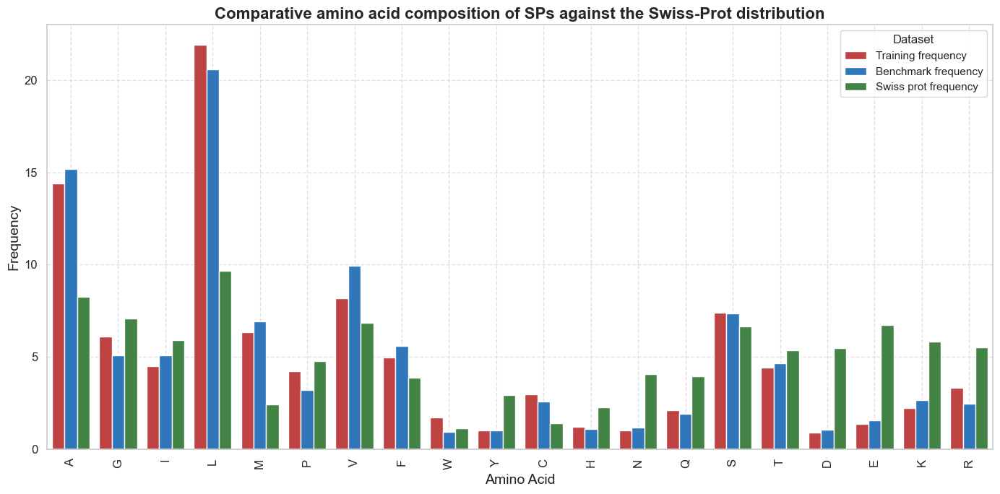

In [135]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define a custom order for the amino acids on the x-axis
amino_acid_order =  [
    'A', 'G','I', 'L', 'M', 'P', 'V', 'F', 'W', 'Y',  # Hydrophobic (Non-polar)
    'C',  # Cysteine (can form disulfide bonds, considered slightly hydrophobic)
    'H', 'N', 'Q', 'S', 'T',  # Hydrophilic (Polar)
    'D', 'E',  # Acidic (Negatively charged)
    'K', 'R'   # Basic (Positively charged)
]
# Transform the data to long format (melt)
frequency_df_long = frequency_df.reset_index().melt(id_vars='Aminoacid', 
                                                    var_name='Dataset', 
                                                    value_name='Frequency')

# Set figure size for better readability
plt.figure(figsize=(14, 7))

# Create a barplot using Seaborn with a stronger color palette
sns.barplot(x='Aminoacid', y='Frequency', hue='Dataset', data=frequency_df_long, 
            palette=["#D32F2F", "#1976D2", "#388E3C"], order=amino_acid_order)  # Added green color

# Enhance the plot with title, labels, and aesthetic improvements
plt.title("Comparative amino acid composition of SPs against the Swiss-Prot distribution", 
          fontsize=16, 
          fontweight='bold')
plt.xlabel("Amino Acid", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.xticks(rotation=90, fontsize=12)  # Rotate x-axis labels for readability
plt.yticks(fontsize=12)

# Add gridlines for better visualization
plt.grid(True, linestyle='--', alpha=0.6)

# Adjust layout to avoid clipping of labels
plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
The analysis of signal peptide (SP) amino acid composition compared to the SwissProt background distribution revealed distinct patterns. SPs were found to be enriched in hydrophobic residues, such as leucine (L), alanine (A), methionine (M), and valine (V), which are essential for interactions with the translocation machinery and membrane association. On the other hand, charged amino acids, like lysine (K), arginine (R), histidine (H), aspartic acid (D), and glutamic acid (E), were significantly less frequent in SPs, aligning with their functional and structural roles. This trend was consistent across both the positive training and benchmark sets, as illustrated in the comparative analysis with SwissProt data (Fig. 4), confirming the characteristic composition of SPs.

In [46]:
frequency_df_long.head(30)

,Aminoacid,Dataset,Frequency
0,A,Training frequency,14.388057
1,C,Training frequency,2.950754
2,D,Training frequency,0.881719
3,E,Training frequency,1.342618
4,F,Training frequency,4.939632
5,G,Training frequency,6.086869
6,H,Training frequency,1.177296
7,I,Training frequency,4.473724
8,K,Training frequency,2.214318
9,L,Training frequency,21.897701


# 4. VON HEIJNE

In [47]:
alphabet = "ACDEFGHIKLMNPQRSTVWY"
aa_to_index = {aa:pos for pos,aa in enumerate(alphabet)}
print(aa_to_index)

{'A': 0, 'C': 1, 'D': 2, 'E': 3, 'F': 4, 'G': 5, 'H': 6, 'I': 7, 'K': 8, 'L': 9, 'M': 10, 'N': 11, 'P': 12, 'Q': 13, 'R': 14, 'S': 15, 'T': 16, 'V': 17, 'W': 18, 'Y': 19}


In [48]:
def update_matrix(seq_list):
    matr = np.ones((20, 15))  # Inizializza una matrice 20x15 con valori 1
    
    for seq in seq_list:
        seq = list(seq)
        
        for i in range(len(seq)):  # Itera sulla sottosequenza
            if seq[i] == "U":
                seq[i] = "C"
            
            if seq[i] in aa_to_index:
                row = aa_to_index[seq[i]]  # Estrae la posizione nell'alfabeto del carattere
                col = i  # La posizione nella sequenza corrisponde alla colonna
                
                # Incrementa il valore nella matrice
                if row < matr.shape[0] and col < matr.shape[1]:  # Verifica che gli indici siano validi
                    matr[row][col] += 1
            else:
                continue  #Ignora i caratteri non validi
    
    norm_matr = matr / (len(seq_list) + 20)  # Divide ogni elemento per il numero di sequenze nella lista
    
    # Frequenze di swiss prot ordinate
    
    aa_sw_ord_freq = [0.08, 0.01, 0.06, 0.07, 0.04, 0.07, 0.02, 0.06, 0.06, 0.10, 0.02, 0.04, 0.05, 0.04, 0.06, 0.07, 0.05, 0.07, 0.01, 0.03]
    aa_sw_ord_freq_array= np.array(aa_sw_ord_freq)

    # Normalizzazione per la frequenza di aminoacidi
    norm_matr_2 = norm_matr / aa_sw_ord_freq_array.reshape(20,1)   # This takes the values from the swiss_prot_freq_sort array and reshapes it by adding a new axis (column) using np.newaxis. This effectively transforms a 1D array into a 2D array with a single column.
    # Logaritmo della matrice
    log_matr = np.log(norm_matr_2)
    
    return log_matr  # Ritorna la matrice logaritmica normalizzata


In [49]:
def get_score(seq, matr):
    max_score = 0
    
    for i in range(len(seq) -14):
        kmer = list(seq[i:i+15]) 
        score = 0 
        
        for k in range(len(kmer)):
            if kmer[k] == "U":
                kmer[k] = "C"
            
            if kmer[k] in aa_to_index:
                row = aa_to_index[kmer[k]]  # Estrae la posizione nell'alfabeto del carattere
                col = k
                score = score + matr[row][col]
                
            else:
                continue  # Ignora i caratteri non validi
            
        #Quando finiscono le lettere del kmer controlliamo se la sottosequenza ha uno score migliore di quello già salvato
        if score > max_score:
            max_score = score

    return max_score

### 4.1 TRAINING VON HEIJNE

In [50]:
def find_optimal_th(classes_list, scores_list):
    y_validation = classes_list

    y_validation_scores = scores_list

    # precision-recall curve values
    # precision: contains precision scores at varying thresholds
    # recall: contains recall scores at varying thresholds
    # thresholds: the thresholds values

    precision, recall, thresholds = precision_recall_curve(y_validation, y_validation_scores) # compute f-scores at varying thresholds
    fscore = (2 * precision * recall) / (precision + recall)

    # get the index of the maximum value of the f-score
    index = numpy.argmax(fscore)
    optimal_threshold = thresholds[index]
    
    return(optimal_threshold)

In [51]:
pos_training_df.groupby("Fold").count()

,Accession,Organism,Kingdom,Length,Cleavage,Type
Fold,,,,,,
0,174,174,174,174,174,174
1,174,174,174,174,174,174
2,174,174,174,174,174,174
3,173,173,173,173,173,173
4,173,173,173,173,173,173


In [52]:
neg_training_df.groupby("Fold").count()

,Accession,Organism,Kingdom,Length,Transmembrane,Type
Fold,,,,,,
0,1407,1407,1407,1407,1407,1407
1,1406,1406,1406,1406,1406,1406
2,1406,1406,1406,1406,1406,1406
3,1406,1406,1406,1406,1406,1406
4,1406,1406,1406,1406,1406,1406


In [53]:
pos_training_df.query("Fold != %i and Fold != %i" %(0,1))

,Accession,Organism,Kingdom,Length,Cleavage,Type,Fold
2,P55847,Penaeus japonicus,Metazoa,105,28,+,2
3,Q02747,Homo sapiens,Metazoa,115,21,+,3
4,Q7KRU8,Drosophila melanogaster,Metazoa,205,19,+,4
7,P54837,Saccharomyces cerevisiae (strain ATCC 204508 /...,Fungi,211,20,+,2
8,P86798,Cupiennius salei,Metazoa,140,19,+,3
...,...,...,...,...,...,...,...
859,Q8NBJ9,Homo sapiens,Metazoa,832,18,+,4
862,O76818,Agrotis ipsilon,Metazoa,193,19,+,2
863,Q9H293,Homo sapiens,Metazoa,177,32,+,3
864,Q27441,Aplysia californica,Metazoa,92,21,+,4


In [54]:
# Initialize lists to store values for each metric across folds
accuracies = []
precisions = []
recalls = []
f1_scores = []
mccs = []

# Initialize a list to store results for each fold
scores_VH_cv = []

best_thresholds = []

for i in range(5):
    testing = i
    validation = (testing + 1) % 5  

    list_subseq_train_fold = []
    list_seq_validation_fold = []
    list_seq_testing_fold = []
    classes_validation = []
    classes_testing = []
    scores_validation = []
    scores_testing = []

    # TRAINING
    training_fold = pos_training_df.query("Fold != %i & Fold != %i" % (testing, validation))
    pos_count_train = training_fold[training_fold['Type'] == '+'].shape[0]
    print(f"Fold {i}:")
    print(f"  Training size = {len(training_fold)}, Positive samples = {pos_count_train}")

    for index, row in training_fold.iterrows():
        code = row["Accession"]
        site = row["Cleavage"]
        s, e = site - 13, site + 2
        sp_subseq = get_seq(total_pos_fasta, code, s, e)
        list_subseq_train_fold.append(sp_subseq)

    pswm = update_matrix(list_subseq_train_fold)

    # VALIDATION
    validation_pos = pos_training_df.query("Fold == %i" % validation)
    validation_neg = neg_training_df.query("Fold == %i" % validation)
    validation_fold = pd.concat([validation_pos, validation_neg])
    pos_count_validation = validation_pos.shape[0]
    neg_count_validation = validation_neg.shape[0]
    print(f"  Validation size = {len(validation_fold)}, Positives = {pos_count_validation}, Negatives = {neg_count_validation}")

    for index, row in validation_fold.iterrows():
        code = row["Accession"]
        class_seq = row["Type"]
        if class_seq == "+":
            validation_pos_seq = get_seq(total_pos_fasta, code, 0, -1)
            list_seq_validation_fold.append(validation_pos_seq)
            classes_validation.append(1)
        else:
            validation_neg_seq = get_seq(total_neg_fasta, code, 0, -1)
            list_seq_validation_fold.append(validation_neg_seq)
            classes_validation.append(0)

    for seq in list_seq_validation_fold:
        score = get_score(seq, pswm)
        scores_validation.append(score)

    precision, recall, thresholds = precision_recall_curve(classes_validation, scores_validation)
    fscore = (2 * precision * recall) / (precision + recall)
    fscore = np.nan_to_num(fscore)
    index = np.argmax(fscore)
    best_th_value = round(thresholds[index], 2)
    best_thresholds.append(best_th_value)
    print(f"  Optimal threshold = {best_th_value}")

    # TESTING
    testing_pos = pos_training_df.query("Fold == %i" % testing)
    testing_neg = neg_training_df.query("Fold == %i" % testing)
    testing_fold = pd.concat([testing_pos, testing_neg])
    pos_count_testing = testing_pos.shape[0]
    neg_count_testing = testing_neg.shape[0]
    print(f"  Testing size = {len(testing_fold)}, Positives = {pos_count_testing}, Negatives = {neg_count_testing}")

    for index, row in testing_fold.iterrows():  
        code = row["Accession"]
        class_seq = row["Type"]
        if class_seq == "+":
            testing_pos_seq = get_seq(total_pos_fasta, code, 0, -1)
            list_seq_testing_fold.append(testing_pos_seq)
            classes_testing.append(1)
        else:
            testing_neg_seq = get_seq(total_neg_fasta, code, 0, -1)
            list_seq_testing_fold.append(testing_neg_seq)
            classes_testing.append(0)

    for seq in list_seq_testing_fold:
        score = get_score(seq, pswm)
        scores_testing.append(score)

    class_pred_test = [1 if t_s >= best_th_value else 0 for t_s in scores_testing]
    y_true = classes_testing
    y_pred = class_pred_test

    cm = confusion_matrix(y_true, y_pred, labels=[1, 0])
    TP, FN, FP, TN = cm[0][0], cm[0][1], cm[1][0], cm[1][1]
    accuracy = round(accuracy_score(y_true, y_pred), 2)
    precision = round(precision_score(y_true, y_pred), 2)
    TPR = round(recall_score(y_true, y_pred), 2)
    f1 = round(f1_score(y_true, y_pred), 2)
    mcc = round(matthews_corrcoef(y_true, y_pred), 2)

    print("  Confusion Matrix [TP, FN | FP, TN]:")
    print(f"    [[{TP}, {FN}],")
    print(f"     [{FP}, {TN}]]")
    print(f"  Accuracy = {accuracy}, Precision = {precision}, Recall = {TPR}, F1 Score = {f1}, MCC = {mcc}")
    print("------")

    # Append the results for the current fold to the list
    scores_VH_cv.append({
        "Training": [j for j in range(5) if j != testing and j != validation],
        "Validation": validation,
        "Testing": testing,
        "Threshold": best_th_value,
        "MCC": mcc,
        "Accuracy": accuracy,
        "Precision": precision,
        "Recall": TPR,
        "F1 Score": f1
    })

    # Store metrics for calculating average and standard error later
    accuracies.append(accuracy)
    precisions.append(precision)
    recalls.append(TPR)
    f1_scores.append(f1)
    mccs.append(mcc)

# After the loop, create a DataFrame and save it as TSV
scores_VH_cv_df = pd.DataFrame(scores_VH_cv)
scores_VH_cv_df.to_csv("VH_cv_results.tsv", sep='\t', index=False)

# Calculate averages and standard errors for all metrics
avg_accuracy = np.mean(accuracies)
avg_f1 = np.mean(f1_scores)
avg_precision = np.mean(precisions)
avg_recall = np.mean(recalls)
avg_mcc = np.mean(mccs)

std_dev_accuracy = np.std(accuracies, ddof=1)
std_dev_f1 = np.std(f1_scores, ddof=1)
std_dev_precision = np.std(precisions, ddof=1)
std_dev_recall = np.std(recalls, ddof=1)
std_dev_mcc = np.std(mccs, ddof=1)

# Calculate standard errors
standard_error_accuracy = std_dev_accuracy / np.sqrt(len(accuracies))
standard_error_f1 = std_dev_f1 / np.sqrt(len(f1_scores))
standard_error_precision = std_dev_precision / np.sqrt(len(precisions))
standard_error_recall = std_dev_recall / np.sqrt(len(recalls))
standard_error_mcc = std_dev_mcc / np.sqrt(len(mccs))

# Prepare the results for the DataFrame
final_results = {
    'Metric': ['Accuracy', 'F1 Score', 'Precision', 'Recall', 'MCC'],
    'Average': [avg_accuracy, avg_f1, avg_precision, avg_recall, avg_mcc],
    'Standard Error': [standard_error_accuracy, standard_error_f1, standard_error_precision, standard_error_recall, standard_error_mcc]
}

# Create a DataFrame with the results
SD_VH_CV_results_df = pd.DataFrame(final_results)

# Assuming SD_VH_CV_results_df is your DataFrame
SD_VH_CV_results_df['Average'] = SD_VH_CV_results_df['Average'].round(2)
SD_VH_CV_results_df['Standard Error'] = SD_VH_CV_results_df['Standard Error'].round(3)

# Optional: Save it to a CSV file if needed
SD_VH_CV_results_df.to_csv("SD_VH_CV_results_rounded.csv", index=False)

# Print to verify the result
print(SD_VH_CV_results_df)
# Print the results
print("\n--- Averaged Results ---")
print(f"Average Accuracy: {avg_accuracy:.3f} ± {standard_error_accuracy:.3f}")
print(f"Average F1 Score: {avg_f1:.3f} ± {standard_error_f1:.3f}")
print(f"Average Precision: {avg_precision:.3f} ± {standard_error_precision:.3f}")
print(f"Average Recall: {avg_recall:.3f} ± {standard_error_recall:.3f}")
print(f"Average MCC: {avg_mcc:.3f} ± {standard_error_mcc:.3f}")

# Print best thresholds and calculate the mean
print("\nBest thresholds per fold:", best_thresholds)
final_th_mean = round(np.nanmean(best_thresholds), 2)
print(f"Final mean threshold = {final_th_mean}")


Fold 0:
  Training size = 520, Positive samples = 520
  Validation size = 1580, Positives = 174, Negatives = 1406


  Optimal threshold = 7.98
  Testing size = 1581, Positives = 174, Negatives = 1407
  Confusion Matrix [TP, FN | FP, TN]:
    [[93, 81],
     [71, 1336]]
  Accuracy = 0.9, Precision = 0.57, Recall = 0.53, F1 Score = 0.55, MCC = 0.5
------
Fold 1:
  Training size = 520, Positive samples = 520
  Validation size = 1580, Positives = 174, Negatives = 1406
  Optimal threshold = 7.03
  Testing size = 1580, Positives = 174, Negatives = 1406
  Confusion Matrix [TP, FN | FP, TN]:
    [[111, 63],
     [129, 1277]]
  Accuracy = 0.88, Precision = 0.46, Recall = 0.64, F1 Score = 0.54, MCC = 0.48
------
Fold 2:
  Training size = 521, Positive samples = 521
  Validation size = 1579, Positives = 173, Negatives = 1406
  Optimal threshold = 8.06
  Testing size = 1580, Positives = 174, Negatives = 1406
  Confusion Matrix [TP, FN | FP, TN]:
    [[80, 94],
     [53, 1353]]
  Accuracy = 0.91, Precision = 0.6, Recall = 0.46, F1 Score = 0.52, MCC = 0.48
------
Fold 3:
  Training size = 522, Positive samples = 

In [55]:
SD_VH_CV_results_df

,Metric,Average,Standard Error
0,Accuracy,0.90,0.005
1,F1 Score,0.55,0.012
2,Precision,0.54,0.024
3,Recall,0.58,0.036
4,MCC,0.50,0.010


In [56]:
scores_VH_cv_df

,Training,Validation,Testing,Threshold,MCC,Accuracy,Precision,Recall,F1 Score
0,"[2, 3, 4]",1,0,7.98,0.50,0.90,0.57,0.53,0.55
1,"[0, 3, 4]",2,1,7.03,0.48,0.88,0.46,0.64,0.54
2,"[0, 1, 4]",3,2,8.06,0.48,0.91,0.60,0.46,0.52
3,"[0, 1, 2]",4,3,7.24,0.53,0.90,0.53,0.65,0.58
4,"[1, 2, 3]",0,4,7.59,0.52,0.90,0.56,0.60,0.58


In [57]:
averaged_final_scores_VH_cv_df = scores_VH_cv_df.iloc[:, 3:].mean().round(2)

In [58]:
averaged_final_scores_VH_cv_df.to_csv("Avergaed scores_VH_cv_df.tsv", sep="\t")

### 4.2 TESTING BENCHMARK 

In [59]:
with open ("logo_seq_train.txt", "r") as inpf:
    train_subseq_80 = [line.strip() for line in inpf]

pwsm_80= update_matrix(train_subseq_80)

In [60]:
# Initialize lists to store sequences, true classes, and scores
list_seq_benchmark = []
classes_benchmark = []
scores_benchmark = []

# Combine positive and negative benchmark data
benchmark_pos_neg = pd.concat([neg_benchmark_df, pos_benchmark_df])

# Process each row in the benchmark dataset
for index, row in benchmark_pos_neg.iterrows():  
    code = row["Accession"]
    class_seq = row["Type"]
    if class_seq == "+":
        benchmark_seq = get_seq(total_pos_fasta, code, 0, -1)
        classes_benchmark.append(1)
    else:
        benchmark_seq = get_seq(total_neg_fasta, code, 0, -1)
        classes_benchmark.append(0)
    
    list_seq_benchmark.append(benchmark_seq)

# Calculate scores for each benchmark sequence
scores_benchmark = [get_score(seq, pswm) for seq in list_seq_benchmark]

# Predict classes based on the final threshold
class_pred_benchmark = [1 if score >= final_th_mean else 0 for score in scores_benchmark]

# Convert predictions and true classes to required format
y_true = classes_benchmark
y_pred = class_pred_benchmark

# Compute confusion matrix and related metrics
cm = confusion_matrix(y_true, y_pred, labels=[1, 0])
TP, FN, FP, TN = cm[0][0], cm[0][1], cm[1][0], cm[1][1]
accuracy = round(accuracy_score(y_true, y_pred), 2)
precision = round(precision_score(y_true, y_pred), 2)
recall = round(recall_score(y_true, y_pred), 2)  # True Positive Rate
f1 = round(f1_score(y_true, y_pred), 2)
mcc = round(matthews_corrcoef(y_true, y_pred), 2)

# Organized output
print("Benchmarking Results:")
print(f"Confusion Matrix [TP, FN | FP, TN]:")
print(f"  [[{TP}, {FN}],")
print(f"   [{FP}, {TN}]]")
print(f"Threshold used: {final_th_mean:.2f}")
print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1 Score: {f1}")
print(f"MCC: {mcc}")

# Optional: Store the results in a dictionary or DataFrame for export
benchmark_results = {
    "Best threshold": final_th_mean,
    "TPs": TP,
    "FPs": FP,
    "FNs": FN,
    "TNs": TN,
    "MCC": mcc,
    "Accuracy": accuracy,
    "Precision": precision,
    "Recall": recall,
    "F1 Score": f1,
}

# To save as a TSV (if needed)
scores_VH_benchmark_df = pd.DataFrame([benchmark_results])
scores_VH_benchmark_df.to_csv("VH_benchmark_results.tsv", sep='\t', index=False)


Benchmarking Results:
Confusion Matrix [TP, FN | FP, TN]:
  [[128, 89],
   [110, 1648]]
Threshold used: 7.58
Accuracy: 0.9
Precision: 0.54
Recall: 0.59
F1 Score: 0.56
MCC: 0.51


In [61]:
scores_VH_benchmark_df

,Best threshold,TPs,FPs,FNs,TNs,MCC,Accuracy,Precision,Recall,F1 Score
0,7.58,128,110,89,1648,0.51,0.9,0.54,0.59,0.56


In [62]:
y_pred_class = ["+" if i==1 else "-" for i in y_pred ] # Transform 1/0 --> +/-

In [63]:
results_benchmark_VH_df = benchmark_pos_neg.copy()
results_benchmark_VH_df["Prediction_VH"] = y_pred_class
results_benchmark_VH_df = results_benchmark_VH_df.rename(columns={
    'Type': 'Type_VH'})


In [64]:
results_benchmark_VH_df

,Accession,Organism,Kingdom,Length,Transmembrane,Type_VH,Cleavage,Prediction_VH
0,O81787,Arabidopsis thaliana,Viridiplantae,527,False,-,NaN,-
1,P04386,Saccharomyces cerevisiae (strain ATCC 204508 /...,Fungi,881,False,-,NaN,-
2,P05084,Drosophila melanogaster,Metazoa,758,False,-,NaN,-
3,P06701,Saccharomyces cerevisiae (strain ATCC 204508 /...,Fungi,978,False,-,NaN,-
4,P06778,Saccharomyces cerevisiae (strain ATCC 204508 /...,Fungi,471,False,-,NaN,-
...,...,...,...,...,...,...,...,...
212,P02896,Trypanosoma brucei brucei,Other,526,NaN,+,33.0,-
213,P03998,Limulus polyphemus,Metazoa,195,NaN,+,20.0,-
214,P0DPU3,Scolopendra dehaani,Metazoa,577,NaN,+,25.0,-
215,P0DUQ6,Conus planorbis,Metazoa,70,NaN,+,21.0,-


# 5. EXTRACT FEATURES

### 5.1 SP composition distribution

In [65]:
alphabet = "ACDEFGHIKLMNPQRSTVWY"

def get_composition(seq):
    n_terminal_seq = seq[:22]

    composition = np.zeros(len(alphabet))
    neglect = 0

    for aa in n_terminal_seq:     # Count occurrences of each amino acid in the N-terminal sequence
        if aa in alphabet:
            index = alphabet.index(aa)
            composition[index] += 1
        else:
            neglect +=1
            
    composition /= ( len(n_terminal_seq) - neglect )     # Normalize by the length of the N-terminal sequence to get the relative composition

    return list(composition)

### 5.2 Hydrophobicity

In [66]:
from Bio.SeqUtils.ProtParam import ProteinAnalysis
from Bio.SeqUtils import ProtParamData

In [67]:
print(ProtParamData.kd)

{'A': 1.8, 'R': -4.5, 'N': -3.5, 'D': -3.5, 'C': 2.5, 'Q': -3.5, 'E': -3.5, 'G': -0.4, 'H': -3.2, 'I': 4.5, 'L': 3.8, 'K': -3.9, 'M': 1.9, 'F': 2.8, 'P': -1.6, 'S': -0.8, 'T': -0.7, 'W': -0.9, 'Y': -1.3, 'V': 4.2}


In [68]:
def get_hp (seq):
    seq = seq[:40]
    window_size = 5
    d = int(window_size/2)
    sequence_with_padding = "X"*d + seq+ "X"*d
    analysed_seq_padding = ProteinAnalysis(sequence_with_padding)

    kd_pos_with_padding = analysed_seq_padding.protein_scale(ProtParamData.kd, window_size)

    max_hp = max(kd_pos_with_padding)
    av_hp = sum(kd_pos_with_padding) / len(kd_pos_with_padding)
    
    return(max_hp,av_hp)

### 5.3 Charge



In [69]:
charge_dict = {'A': 0, 'R': 1, 'N': 0, 'D': 0, 'C':0, 'Q': 0, 'E': 0, 'G': 0, 'H': 1, 'I': 0, 'L':0, 'K': 1, 'M': 0, 'F': 0, 'P': 0, 'S': 0, 'T': 0, 'W': 0, 'Y': 0, 'V': 0}
print(charge_dict)

{'A': 0, 'R': 1, 'N': 0, 'D': 0, 'C': 0, 'Q': 0, 'E': 0, 'G': 0, 'H': 1, 'I': 0, 'L': 0, 'K': 1, 'M': 0, 'F': 0, 'P': 0, 'S': 0, 'T': 0, 'W': 0, 'Y': 0, 'V': 0}


In [70]:
def get_charge (seq):
    seq = seq[:40]
    window_size = 3
    d = int(window_size/2)
    sequence_with_padding = "X"*d + seq+ "X"*d
    
    analysed_seq_padding = ProteinAnalysis(sequence_with_padding)
    ch_pos_with_padding = analysed_seq_padding.protein_scale(charge_dict, window_size)

    max_ch = max(ch_pos_with_padding)
    
    norm_pos = ch_pos_with_padding.index(max_ch) /len(seq)
    
    return(max_ch, 1-norm_pos)
#Transfrom the number obtained of norm pos do: 1 - norm_post 
#The extimation of the corresponsind weight woul be better

### 5.4 Alpha helix propensity

In [71]:
ah_dict = {
    'A': 1.420,
    'R': 0.980,
    'N': 0.670,
    'D': 1.010,
    'C': 0.700,
    'Q': 1.110,
    'E': 1.510,
    'G': 0.570,
    'H': 1.000,
    'I': 1.080,
    'L': 1.210,
    'K': 1.160,
    'M': 1.450,
    'F': 1.130,
    'P': 0.570,
    'S': 0.770,
    'T': 0.830,
    'W': 1.080,
    'Y': 0.690,
    'V': 1.060
}


In [72]:
def get_ah (seq):
    seq = seq[:40]
    window_size = 7
    d = int(window_size/2)
    sequence_with_padding = "X"*d + seq+ "X"*d
    analysed_seq_padding = ProteinAnalysis(sequence_with_padding)

    ah_pos_with_padding = analysed_seq_padding.protein_scale(ah_dict,window_size)

    max_ah = max(ah_pos_with_padding)
    av_ah = sum(ah_pos_with_padding) / len(ah_pos_with_padding)
    
    return(max_ah,av_ah)

### 5.5 Transmembrane tendency

In [73]:
tm_dict= {
    'A': 0.380,
    'R': -2.570,
    'N': -1.620,
    'D': -3.270,
    'C': -0.300,
    'Q': -1.840,
    'E': -2.900,
    'G': -0.190,
    'H': -1.440,
    'I': 1.970,
    'L': 1.820,
    'K': -3.460,
    'M': 1.400,
    'F': 1.980,
    'P': -1.440,
    'S': -0.530,
    'T': -0.320,
    'W': 1.530,
    'Y': 0.490,
    'V': 1.460
}


In [74]:
def get_tm (seq):
    seq = seq[:40]
    window_size = 7
    d = int(window_size/2)
    sequence_with_padding = "X"*d + seq+ "X"*d
    analysed_seq_padding = ProteinAnalysis(sequence_with_padding)

    tm_pos_with_padding = analysed_seq_padding.protein_scale(tm_dict, window_size)

    max_tm = max(tm_pos_with_padding)
    av_tm = sum(tm_pos_with_padding) / len(tm_pos_with_padding)
    
    return(max_tm,av_tm)

In [75]:
# pos_training_df = 868
# neg_training_df 7031


### 5.6 Dataframe: ID and features 

In [76]:
pos_training_df.head()


,Accession,Organism,Kingdom,Length,Cleavage,Type,Fold
0,C4NZN9,Hyas araneus,Metazoa,131,16,+,0
1,O14412,Orpinomyces sp. (strain PC-2),Fungi,245,29,+,1
2,P55847,Penaeus japonicus,Metazoa,105,28,+,2
3,Q02747,Homo sapiens,Metazoa,115,21,+,3
4,Q7KRU8,Drosophila melanogaster,Metazoa,205,19,+,4


In [77]:
training_df.shape

(7899, 8)

In [78]:
feature_list =[]

for index, row in training_df.iterrows():
    if row["Type"]=="+":
        code = row["Accession"]
        seq = get_seq(total_pos_fasta,code,0,-1)
        
    else:
        code = row["Accession"]
        seq = get_seq(total_neg_fasta,code,0,-1)
        
    label = row["Type"]
    fold = row["Fold"]
    composition = get_composition(seq)
    max_hydro, avg_hydro = get_hp(seq)
    max_charge, norm_pos = get_charge(seq)
    max_helix, avg_helix = get_ah(seq)
    max_tm, avg_tm = get_tm(seq)

    features_of_one_protein= composition + [max_hydro,avg_hydro, max_charge,norm_pos,max_helix, avg_helix, max_tm, avg_tm] #Merge the 2 lists
    feature_list.append([code] + features_of_one_protein + [label] + [fold]) 
    
columns = ["AA_%s" % i for i in range(1, 21)] + [
    "Max_HP", "Avg_HP", "Max_CH", "Norm_CH", 
    "Max_AH", "Avg_AH", "Max_TM", "Avg_TM", "Type","Fold"]

# Create the DataFrame
training_SVM_df= pd.DataFrame(feature_list, columns=["Accession"] + columns)
training_SVM_df.set_index("Accession", inplace=True)

    
    
        

In [79]:
training_SVM_df.head(30)


,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type,Fold
Accession,,,,,,,,,,,,,,,,,,,,,
C4NZN9,0.181818,0.000000,0.000000,0.045455,0.045455,0.000000,0.045455,0.045455,0.045455,0.272727,...,4.02,0.6305,0.666667,0.475,1.342857,0.943143,1.454286,0.087821,+,0
O14412,0.181818,0.000000,0.000000,0.000000,0.000000,0.045455,0.000000,0.181818,0.090909,0.136364,...,3.18,0.6840,0.333333,0.975,1.181429,0.931179,1.167143,0.093214,+,1
P55847,0.090909,0.000000,0.000000,0.000000,0.000000,0.045455,0.000000,0.090909,0.000000,0.181818,...,4.32,0.9160,0.333333,0.975,1.198571,0.939643,1.512857,0.281464,+,2
Q02747,0.272727,0.045455,0.000000,0.000000,0.045455,0.136364,0.000000,0.000000,0.000000,0.272727,...,3.14,0.8080,0.666667,0.100,1.220000,0.967929,1.095714,0.160179,+,3
Q7KRU8,0.181818,0.000000,0.045455,0.000000,0.045455,0.045455,0.000000,0.045455,0.090909,0.227273,...,3.56,0.7065,0.333333,0.975,1.242857,1.008929,1.511429,-0.068429,+,4
B0CPC6,0.181818,0.045455,0.000000,0.000000,0.090909,0.045455,0.045455,0.000000,0.045455,0.181818,...,3.48,0.3200,0.333333,0.900,1.278571,0.956500,1.357143,-0.036393,+,0
P01350,0.227273,0.045455,0.000000,0.045455,0.090909,0.000000,0.000000,0.045455,0.000000,0.181818,...,3.42,0.2225,0.666667,0.400,1.318571,0.963250,1.452857,-0.132714,+,1
P54837,0.045455,0.000000,0.000000,0.000000,0.000000,0.045455,0.045455,0.045455,0.000000,0.272727,...,3.64,0.8110,0.333333,0.500,1.181429,0.972536,1.197143,0.120000,+,2
P86798,0.136364,0.000000,0.045455,0.000000,0.000000,0.045455,0.045455,0.090909,0.045455,0.136364,...,3.64,0.2610,0.666667,0.975,1.198571,0.809571,1.285714,0.036500,+,3


In [80]:
training_SVM_df.head()

,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type,Fold
Accession,,,,,,,,,,,,,,,,,,,,,
C4NZN9,0.181818,0.000000,0.000000,0.045455,0.045455,0.000000,0.045455,0.045455,0.045455,0.272727,...,4.02,0.6305,0.666667,0.475,1.342857,0.943143,1.454286,0.087821,+,0
O14412,0.181818,0.000000,0.000000,0.000000,0.000000,0.045455,0.000000,0.181818,0.090909,0.136364,...,3.18,0.6840,0.333333,0.975,1.181429,0.931179,1.167143,0.093214,+,1
P55847,0.090909,0.000000,0.000000,0.000000,0.000000,0.045455,0.000000,0.090909,0.000000,0.181818,...,4.32,0.9160,0.333333,0.975,1.198571,0.939643,1.512857,0.281464,+,2
Q02747,0.272727,0.045455,0.000000,0.000000,0.045455,0.136364,0.000000,0.000000,0.000000,0.272727,...,3.14,0.8080,0.666667,0.100,1.220000,0.967929,1.095714,0.160179,+,3
Q7KRU8,0.181818,0.000000,0.045455,0.000000,0.045455,0.045455,0.000000,0.045455,0.090909,0.227273,...,3.56,0.7065,0.333333,0.975,1.242857,1.008929,1.511429,-0.068429,+,4


In [81]:
print(training_SVM_df)

               AA_1      AA_2      AA_3      AA_4      AA_5      AA_6  \
Accession                                                               
C4NZN9     0.181818  0.000000  0.000000  0.045455  0.045455  0.000000   
O14412     0.181818  0.000000  0.000000  0.000000  0.000000  0.045455   
P55847     0.090909  0.000000  0.000000  0.000000  0.000000  0.045455   
Q02747     0.272727  0.045455  0.000000  0.000000  0.045455  0.136364   
Q7KRU8     0.181818  0.000000  0.045455  0.000000  0.045455  0.045455   
...             ...       ...       ...       ...       ...       ...   
Q8IWA0     0.045455  0.045455  0.000000  0.181818  0.045455  0.090909   
Q9VKB9     0.045455  0.090909  0.045455  0.136364  0.090909  0.090909   
Q15067     0.045455  0.000000  0.090909  0.090909  0.045455  0.000000   
Q9HA38     0.045455  0.000000  0.000000  0.000000  0.000000  0.000000   
P82094     0.181818  0.000000  0.000000  0.000000  0.090909  0.000000   

               AA_7      AA_8      AA_9     AA_10 

In [82]:
from itertools import combinations

features = ['HP', 'CH', 'AH', 'TM']
all_combinations = [['AA']]  

for r in range(1, 5):  
    comb = list(combinations(features, r))  
    for c in comb:
        all_combinations.append(['AA'] + list(c))  


print((all_combinations))



[['AA'], ['AA', 'HP'], ['AA', 'CH'], ['AA', 'AH'], ['AA', 'TM'], ['AA', 'HP', 'CH'], ['AA', 'HP', 'AH'], ['AA', 'HP', 'TM'], ['AA', 'CH', 'AH'], ['AA', 'CH', 'TM'], ['AA', 'AH', 'TM'], ['AA', 'HP', 'CH', 'AH'], ['AA', 'HP', 'CH', 'TM'], ['AA', 'HP', 'AH', 'TM'], ['AA', 'CH', 'AH', 'TM'], ['AA', 'HP', 'CH', 'AH', 'TM']]


In [83]:
def find_columns(substrings:list): 
    matched_columns = [] 

    # Iterate in the dataframe columns 
    for col in training_SVM_df.columns:
        for sub in substrings:
            if sub in col:  
                matched_columns.append(col)   # Imposta match_found su True
    matched_columns = matched_columns + ["Type"] + ["Fold"]
    return matched_columns  # Restituisci la lista delle colonne corrispondenti


# 6. SVM


### 6.1 Training/ Validation on 80% 

In [84]:
# List to store all cross-validation results and encoding summaries
final_encoding_results = []  # Final list to store results of each encoding combination
all_cv_result_summary = []  # Detailed summary for each cross-validation fold

# Iterate through all feature encoding combinations
for encode in all_combinations:
    print(f"\n--- Processing Encoding Combination: {encode} ---") 
    matched_columns = find_columns(encode)
    sub_df = training_SVM_df[matched_columns]
    
    # Initialize lists to store performance metrics for averaging
    accuracies, f1_scores, precisions, recalls, mccs = [], [], [], [], []     
    best_c_values, best_gamma_values = [], []  # For storing the best C and gamma values for each fold
    
    # Cross-validation loop (5-fold)
    for fold in range(5):
        testing = fold
        validation = (fold + 1) % 5
        print(f"\n  Iteration: {fold+1}: Training on folds other than {testing} and {validation}, "
              f"validating on fold {validation}, testing on fold {testing}")
        
        # Prepare training fold (excluding testing and validation folds)
        sub_df_training_fold = sub_df.query("Fold != %i & Fold != %i" % (testing, validation)).copy()
        
        # Apply MinMax scaling to numeric columns (if necessary)
        if encode != ["AA"]:  # If encoding is not "AA", apply scaling
            scaler = MinMaxScaler()
            numeric_columns = sub_df_training_fold.select_dtypes(include=np.number).columns
            features_to_scale = numeric_columns[20:training_SVM_df.shape[1] - 2]

            # Ensure selected features are converted to float
            sub_df_training_fold[features_to_scale] = sub_df_training_fold[features_to_scale].astype(float)

            # Scale the features
            scaled_values = scaler.fit_transform(sub_df_training_fold[features_to_scale])
            sub_df_training_fold.loc[:, features_to_scale] = scaled_values.astype(float)
        else:
            features_to_scale = []  # No scaling for "AA"

        X_train = sub_df_training_fold.drop(columns=['Type', 'Fold'])
        Y_train = sub_df_training_fold['Type']
        
        # Prepare validation fold
        sub_df_validation_fold = sub_df.query("Fold == %i" % validation).copy()

        # Apply the same scaling to the validation set
        if encode != ["AA"]:
            sub_df_validation_fold[features_to_scale] = sub_df_validation_fold[features_to_scale].astype(float)
            scaled_validation_values = scaler.transform(sub_df_validation_fold[features_to_scale])
            sub_df_validation_fold.loc[:, features_to_scale] = scaled_validation_values.astype(float)
        
        X_validation = sub_df_validation_fold.drop(columns=['Type', 'Fold'])
        Y_validation = sub_df_validation_fold['Type']

        # Initialize variables to track the best hyperparameters for this fold
        best_mcc = 0
        best_c = None
        best_gamma = None

        # Iterate over hyperparameters C and gamma to find the best combination
        for c in [1, 2, 4, 8]:
            for g in [0.5, 1, 2, "scale"]:
                
                # Train the SVM model
                svm_model = SVC(C=c, kernel='rbf', gamma=g)
                svm_model.fit(X_train, Y_train)

                # Validate the model
                Y_pred_val = svm_model.predict(X_validation)
                mcc = matthews_corrcoef(Y_validation, Y_pred_val)
                
                # Update best hyperparameters based on MCC
                if mcc > best_mcc:
                    best_mcc = mcc
                    best_c = c
                    best_gamma = g

        # Testing phase (on the testing fold)
        sub_df_testing_fold = sub_df.query("Fold == %i" % testing).copy()

        # Apply the same scaling to the testing set if necessary
        if encode != ["AA"]:
            sub_df_testing_fold[features_to_scale] = sub_df_testing_fold[features_to_scale].astype(float)
            scaled_testing_values = scaler.transform(sub_df_testing_fold[features_to_scale])
            sub_df_testing_fold.loc[:, features_to_scale] = scaled_testing_values.astype(float)
        
        X_testing = sub_df_testing_fold.drop(columns=['Type', 'Fold'])
        Y_testing = sub_df_testing_fold['Type']
        
        # Train with the best hyperparameters found
        svm_model = SVC(C=best_c, kernel='rbf', gamma=best_gamma)
        svm_model.fit(X_train, Y_train) 
        
        Y_pred_test = svm_model.predict(X_testing)

        # Save the best C and gamma values for frequency counting
        best_c_values.append(best_c)
        best_gamma_values.append(best_gamma)

        # Calculate testing metrics
        accuracy_test = accuracy_score(Y_testing, Y_pred_test)
        f1_test = f1_score(Y_testing, Y_pred_test, average='weighted') 
        precision_test = precision_score(Y_testing, Y_pred_test, average='weighted')
        recall_test = recall_score(Y_testing, Y_pred_test, average='weighted')
        mcc_test = matthews_corrcoef(Y_testing, Y_pred_test)

        # Store performance metrics
        accuracies.append(accuracy_test)
        f1_scores.append(f1_test)
        precisions.append(precision_test)
        recalls.append(recall_test)
        mccs.append(mcc_test)

        # Save a detailed summary of the fold's results
        all_cv_result_summary.append({
            'Training Encodings': ', '.join(map(str, encode)),
            'Validation Fold': validation,
            'Testing Fold': testing,
            'Best C (Validation)': best_c,
            'Best Gamma (Validation)': best_gamma,
            'MCC on test fold': best_mcc
        })

    c_count = {}
    gamma_count = {}

    for c in best_c_values:
        c_count[c] = c_count.get(c, 0) + 1

    for g in best_gamma_values:
        gamma_count[g] = gamma_count.get(g, 0 )+ 1


    # Find the most frequent C
    max_c_frequency = max(c_count.values())
    most_frequent_c_candidates = []
    for c, freq in c_count.items():
        if freq == max_c_frequency:
            most_frequent_c_candidates.append(c)

    most_frequent_c = min(most_frequent_c_candidates)  # Select the lowest C in case of tie

    # Find the most frequent Gamma
    max_gamma_frequency = max(gamma_count.values())
    most_frequent_gamma_candidates = []
    for g, freq in gamma_count.items():
        if freq == max_gamma_frequency:
            most_frequent_gamma_candidates.append(g)
            
    if "scale" in most_frequent_gamma_candidates and len(most_frequent_gamma_candidates) >1:
        most_frequent_gamma_candidates.remove("scale") 
        most_frequent_gamma = min(most_frequent_gamma_candidates) 
        
    elif "scale" in most_frequent_gamma_candidates and len(most_frequent_gamma_candidates) ==1:
        most_frequent_gamma = "scale"
    else:
        most_frequent_gamma = min(most_frequent_gamma_candidates)  # Select the lowest gamma in case of tie
    
    # Compute average values for each metric
    avg_accuracy = np.mean(accuracies)
    avg_f1 = np.mean(f1_scores)
    avg_precision = np.mean(precisions)
    avg_recall = np.mean(recalls)
    avg_mcc = np.mean(mccs)

    # Compute standard deviation and standard error for each metric
    std_dev_accuracy = np.std(accuracies, ddof=1)
    std_dev_f1 = np.std(f1_scores, ddof=1)
    std_dev_precision = np.std(precisions, ddof=1)
    std_dev_recall = np.std(recalls, ddof=1)
    std_dev_mcc = np.std(mccs, ddof=1)

    # Calculate standard errors
    standard_error_accuracy = std_dev_accuracy / np.sqrt(len(accuracies))
    standard_error_f1 = std_dev_f1 / np.sqrt(len(f1_scores))
    standard_error_precision = std_dev_precision / np.sqrt(len(precisions))
    standard_error_recall = std_dev_recall / np.sqrt(len(recalls))
    standard_error_mcc = std_dev_mcc / np.sqrt(len(mccs))

    # Store final results for this encoding combination
    final_encoding_results.append({
        'Best encoding Combination': ', '.join(map(str, encode)),
        'Most Frequent C': most_frequent_c,
        'Most Frequent Gamma': most_frequent_gamma,
        'Average MCC': avg_mcc,
        'Standard Error MCC': standard_error_mcc,
        'Average Accuracy': avg_accuracy,
        'Standard Error Accuracy': standard_error_accuracy,
        'Average F1 Score': avg_f1,
        'Standard Error F1 Score': standard_error_f1,
        'Average Precision': avg_precision,
        'Standard Error Precision': standard_error_precision,
        'Average Recall': avg_recall,
        'Standard Error Recall': standard_error_recall
        })


# Create a DataFrame with all averaged results (separated averages and standard errors)
scores_SVM_cv_df = pd.DataFrame(final_encoding_results)
scores_SVM_cv_df.to_csv('SVM_cv_results.csv', sep='\t', index=False)

# Find the best overall combination based on average MCC
best_result = max(final_encoding_results, key=lambda x: x['Average MCC'])

# Print the best overall encoding result in a detailed format
print("\n--- Final Results ---")
print(f"Best encoding Combination: {best_result['Best encoding Combination']}")
print(f"Best Average MCC: {best_result['Average MCC']}")
print(f"Optimal C: {best_result['Most Frequent C']}, Optimal Gamma: {best_result['Most Frequent Gamma']}")

# Ensure encoding names are properly formatted as strings
encoding_names = [result['Best encoding Combination'] for result in final_encoding_results]
mcc_values = [result['Average MCC'] for result in final_encoding_results]

# Save and print the detailed summary of all CV folds
all_cv_result_summary_df = pd.DataFrame(all_cv_result_summary)
all_cv_result_summary_df.to_csv('SVM_cv_summary.csv', sep='\t', index=False)
print("\nCross-Validation details saved to 'SVM_cv_summary.csv'")
print("Averaged encoding results saved to 'SVM_cv_results.csv'")



--- Processing Encoding Combination: ['AA'] ---

  Iteration: 1: Training on folds other than 0 and 1, validating on fold 1, testing on fold 0



  Iteration: 2: Training on folds other than 1 and 2, validating on fold 2, testing on fold 1

  Iteration: 3: Training on folds other than 2 and 3, validating on fold 3, testing on fold 2

  Iteration: 4: Training on folds other than 3 and 4, validating on fold 4, testing on fold 3

  Iteration: 5: Training on folds other than 4 and 0, validating on fold 0, testing on fold 4

--- Processing Encoding Combination: ['AA', 'HP'] ---

  Iteration: 1: Training on folds other than 0 and 1, validating on fold 1, testing on fold 0

  Iteration: 2: Training on folds other than 1 and 2, validating on fold 2, testing on fold 1

  Iteration: 3: Training on folds other than 2 and 3, validating on fold 3, testing on fold 2

  Iteration: 4: Training on folds other than 3 and 4, validating on fold 4, testing on fold 3

  Iteration: 5: Training on folds other than 4 and 0, validating on fold 0, testing on fold 4

--- Processing Encoding Combination: ['AA', 'CH'] ---

  Iteration: 1: Training on folds 

KeyboardInterrupt: 

In [ ]:
all_cv_result_summary_df.head(20)

,Training Encodings,Validation Fold,Testing Fold,Best C (Validation),Best Gamma (Validation),MCC on test fold
0,AA,1,0,4,2,0.786545
1,AA,2,1,8,2,0.774890
2,AA,3,2,8,2,0.830377
3,AA,4,3,4,scale,0.777092
4,AA,0,4,4,2,0.803690
5,"AA, HP",1,0,8,2,0.819425
6,"AA, HP",2,1,2,2,0.796236
7,"AA, HP",3,2,8,scale,0.839028
8,"AA, HP",4,3,8,2,0.827540
9,"AA, HP",0,4,2,2,0.849455


In [ ]:
best_result["Best encoding Combination"]

'AA, CH, TM'

In [ ]:
# Query the DataFrame for the specific combination
best_feature_combination_of_CV = scores_SVM_cv_df.query("`Best encoding Combination` == 'AA, HP, CH, TM'")

best_feature_combination_of_CV


,Best encoding Combination,Most Frequent C,Most Frequent Gamma,Average MCC,Standard Error MCC,Average Accuracy,Standard Error Accuracy,Average F1 Score,Standard Error F1 Score,Average Precision,Standard Error Precision,Average Recall,Standard Error Recall
12,"AA, HP, CH, TM",8,1,0.861333,0.008205,0.972655,0.001848,0.972745,0.001744,0.9729,0.001615,0.972655,0.001848


In [ ]:
# Query the DataFrame for the specific combination
best_feature_combination_of_CV = scores_SVM_cv_df.query("`Best encoding Combination` == 'AA, HP, CH, TM'")

# Strip spaces from column names to avoid discrepancies
best_feature_combination_of_CV.columns = best_feature_combination_of_CV.columns.str.strip()

# Round columns starting with "Average" to 2 decimal places
average_columns = [col for col in best_feature_combination_of_CV.columns if col.startswith("Average")]
best_feature_combination_of_CV[average_columns] = best_feature_combination_of_CV[average_columns].round(2)

# Round columns starting with "Standard" to 3 decimal places
standard_columns = [col for col in best_feature_combination_of_CV.columns if col.startswith("Standard")]
best_feature_combination_of_CV[standard_columns] = best_feature_combination_of_CV[standard_columns].round(3)

# Save the rounded DataFrame to a CSV
best_feature_combination_of_CV.to_csv("best_feature_combination_of_CV_rounded.csv", index=False)

# Optional: print to verify the output
print(best_feature_combination_of_CV)


   Best encoding Combination  Most Frequent C Most Frequent Gamma  \
12            AA, HP, CH, TM                8                   1   

    Average MCC  Standard Error MCC  Average Accuracy  \
12         0.86               0.008              0.97   

    Standard Error Accuracy  Average F1 Score  Standard Error F1 Score  \
12                    0.002              0.97                    0.002   

    Average Precision  Standard Error Precision  Average Recall  \
12               0.97                     0.002            0.97   

    Standard Error Recall  
12                  0.002  


/var/folders/3w/ln6gq34d5334mr0rz50b0q840000gn/T/ipykernel_9649/3127182124.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  best_feature_combination_of_CV[average_columns] = best_feature_combination_of_CV[average_columns].round(2)
/var/folders/3w/ln6gq34d5334mr0rz50b0q840000gn/T/ipykernel_9649/3127182124.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  best_feature_combination_of_CV[standard_columns] = best_feature_combination_of_CV[standard_columns].round(3)


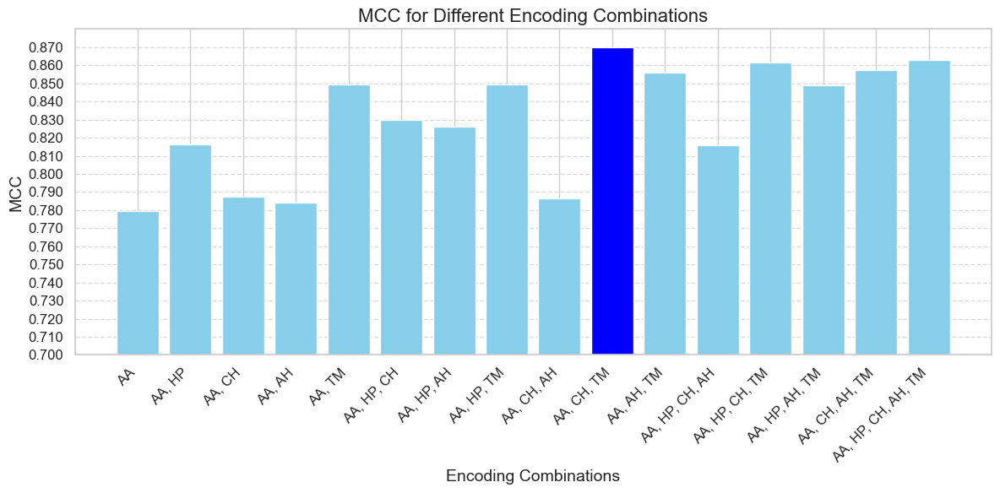

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

highlight_encoding = best_result["Best encoding Combination"]

# Identify the index of the highlighted encoding in the encoding_names list
try:
    highlight_index = encoding_names.index(highlight_encoding)
except ValueError:
    print(f"Encoding '{highlight_encoding}' not found in encoding_names.")
    highlight_index = -1  # Handle error appropriately

# Create a list of colors: set all bars to 'skyblue' except the highlighted one
colors = ['skyblue'] * len(encoding_names)
if highlight_index != -1:
    colors[highlight_index] = 'blue'  # Set the color of the highlighted encoding to blue

# Plotting the MCC results with higher precision on the y-axis
plt.figure(figsize=(12, 6))
plt.bar(encoding_names, mcc_values, color=colors)  # Use the colors list for bar colors
plt.xlabel('Encoding Combinations', fontsize=14)
plt.ylabel('MCC', fontsize=14)
plt.title('MCC for Different Encoding Combinations', fontsize=16)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

# Set the Y-axis to start from 7.5 and adjust the upper limit
plt.ylim(0.7, max(mcc_values) + 0.01)

# Set Y-ticks between 0.70, 0.71, 0.72, etc.
y_ticks = np.arange(0.70, max(mcc_values) + 0.01, 0.01)
plt.yticks(y_ticks)

# Format the Y-axis labels to show three decimal places
plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.3f}'))

# Add gridlines for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Tight layout for better spacing
plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
#summary_df.head(20)

### 6.2 Training again on the 80% with the best feature encoding and hyperparameters

##### 6.2.1 Create the training and benchmark df merging metadata with feature encoding 

In [ ]:
training_SVM_df.head()

,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type,Fold
Accession,,,,,,,,,,,,,,,,,,,,,
Q27082,0.045455,0.181818,0.000000,0.045455,0.000000,0.045455,0.090909,0.045455,0.000000,0.181818,...,3.62,0.5725,0.333333,0.775,1.110000,0.914500,1.188571,-0.065214,+,0
Q8T0Y7,0.136364,0.090909,0.045455,0.000000,0.045455,0.000000,0.000000,0.045455,0.000000,0.136364,...,2.58,0.5005,0.666667,0.225,1.238571,0.942107,0.891429,-0.032821,+,1
P05790,0.136364,0.090909,0.000000,0.000000,0.045455,0.000000,0.000000,0.045455,0.045455,0.090909,...,3.56,0.1895,0.666667,0.950,1.095714,0.905857,1.001429,-0.195607,+,2
Q8BSU2,0.090909,0.000000,0.000000,0.000000,0.181818,0.090909,0.000000,0.000000,0.000000,0.363636,...,3.40,0.6175,0.666667,0.975,1.228571,0.880214,1.682857,0.120036,+,3
Q9H9K5,0.090909,0.000000,0.000000,0.000000,0.045455,0.045455,0.000000,0.045455,0.000000,0.318182,...,3.12,0.8730,0.333333,0.400,1.171429,0.946321,1.301429,0.345607,+,4


In [ ]:
### Create the training dataframe with the best feature encoding
best_matched_columns = find_columns(best_result["Best encoding Combination"])
best_matched_columns = list(dict.fromkeys(best_matched_columns))
best_training_df= training_SVM_df[best_matched_columns]
best_training_df.shape


(7899, 30)

In [ ]:
best_training_df.head()

,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type,Fold
Accession,,,,,,,,,,,,,,,,,,,,,
Q27082,0.045455,0.181818,0.000000,0.045455,0.000000,0.045455,0.090909,0.045455,0.000000,0.181818,...,3.62,0.5725,0.333333,0.775,1.110000,0.914500,1.188571,-0.065214,+,0
Q8T0Y7,0.136364,0.090909,0.045455,0.000000,0.045455,0.000000,0.000000,0.045455,0.000000,0.136364,...,2.58,0.5005,0.666667,0.225,1.238571,0.942107,0.891429,-0.032821,+,1
P05790,0.136364,0.090909,0.000000,0.000000,0.045455,0.000000,0.000000,0.045455,0.045455,0.090909,...,3.56,0.1895,0.666667,0.950,1.095714,0.905857,1.001429,-0.195607,+,2
Q8BSU2,0.090909,0.000000,0.000000,0.000000,0.181818,0.090909,0.000000,0.000000,0.000000,0.363636,...,3.40,0.6175,0.666667,0.975,1.228571,0.880214,1.682857,0.120036,+,3
Q9H9K5,0.090909,0.000000,0.000000,0.000000,0.045455,0.045455,0.000000,0.045455,0.000000,0.318182,...,3.12,0.8730,0.333333,0.400,1.171429,0.946321,1.301429,0.345607,+,4


In [ ]:
### scaling
scaler = MinMaxScaler()
numeric_columns = best_training_df.select_dtypes(include=np.number).columns
features_to_scale = numeric_columns[20:best_training_df.shape[1]-2]

# Ensure selected features are converted to float
best_training_df[features_to_scale] = best_training_df[features_to_scale].astype(float)

# Fit and transform only on numeric features
scaled_values = scaler.fit_transform(best_training_df[features_to_scale])
best_training_df.loc[:, features_to_scale] = scaled_values.astype(float)  # Explicitly cast to float

best_training_df.head()

,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type,Fold
Accession,,,,,,,,,,,,,,,,,,,,,
Q27082,0.045455,0.181818,0.000000,0.045455,0.000000,0.045455,0.090909,0.045455,0.000000,0.181818,...,0.842912,0.735487,0.333333,0.763158,0.375000,0.547692,0.663620,0.700434,+,0
Q8T0Y7,0.136364,0.090909,0.045455,0.000000,0.045455,0.000000,0.000000,0.045455,0.000000,0.136364,...,0.643678,0.720287,0.666667,0.184211,0.575893,0.594447,0.536868,0.711649,+,1
P05790,0.136364,0.090909,0.000000,0.000000,0.045455,0.000000,0.000000,0.045455,0.045455,0.090909,...,0.831418,0.654634,0.666667,0.947368,0.352679,0.533055,0.583790,0.655291,+,2
Q8BSU2,0.090909,0.000000,0.000000,0.000000,0.181818,0.090909,0.000000,0.000000,0.000000,0.363636,...,0.800766,0.744986,0.666667,0.973684,0.560268,0.489627,0.874467,0.764568,+,3
Q9H9K5,0.090909,0.000000,0.000000,0.000000,0.045455,0.045455,0.000000,0.045455,0.000000,0.318182,...,0.747126,0.798923,0.333333,0.368421,0.470982,0.601585,0.711761,0.842662,+,4


In [ ]:
features_to_scale

Index(['Max_HP', 'Avg_HP', 'Max_CH', 'Norm_CH', 'Max_AH', 'Avg_AH', 'Max_TM',
       'Avg_TM'],
      dtype='object')

In [ ]:
benchmark_df.columns

Index(['Accession', 'Organism', 'Kingdom', 'Length', 'Cleavage', 'Type',
       'Transmembrane'],
      dtype='object')

In [ ]:
# Clean the column names to avoid leading/trailing spaces
benchmark_df.columns = benchmark_df.columns.str.strip()

# Now check if 'Type' exists
if 'Type' in benchmark_df.columns:
    feature_list = []
    
    for index, row in benchmark_df.iterrows():
        if row["Type"] == "+":
            code = row["Accession"]
            seq = get_seq(total_pos_fasta, code, 0, -1)
        else:
            code = row["Accession"]
            seq = get_seq(total_neg_fasta, code, 0, -1)
        
        label = row["Type"]
        composition = get_composition(seq)
        max_hydro, avg_hydro = get_hp(seq)
        max_charge, norm_pos = get_charge(seq)
        max_helix, avg_helix = get_ah(seq)
        max_tm, avg_tm = get_tm(seq)
        features_of_one_protein_benchmark = composition + [max_hydro, avg_hydro, max_charge, norm_pos, max_helix, avg_helix, max_tm, avg_tm] # Merge the 2 lists
        feature_list.append([code] + features_of_one_protein_benchmark + [label])
    
    columns = ["AA_%s" % i for i in range(1, 21)] + [
        "Max_HP", "Avg_HP", "Max_CH", "Norm_CH", 
        "Max_AH", "Avg_AH", "Max_TM", "Avg_TM", "Type"]
    
    # Create the DataFrame
    benchmark_SVM_df = pd.DataFrame(feature_list, columns=["Accession"] + columns)
    benchmark_SVM_df.set_index("Accession", inplace=True)
    print(benchmark_SVM_df.head())
else:
    print("Column 'Type' not found in the DataFrame.")


               AA_1      AA_2  AA_3      AA_4      AA_5      AA_6      AA_7  \
Accession                                                                     
P21128     0.181818  0.090909   0.0  0.045455  0.000000  0.090909  0.000000   
P28039     0.045455  0.000000   0.0  0.000000  0.045455  0.000000  0.000000   
P28335     0.045455  0.000000   0.0  0.000000  0.045455  0.045455  0.090909   
P36897     0.409091  0.000000   0.0  0.045455  0.000000  0.000000  0.000000   
P40259     0.136364  0.000000   0.0  0.000000  0.000000  0.000000  0.045455   

               AA_8      AA_9     AA_10  ...  AA_20  Max_HP  Avg_HP    Max_CH  \
Accession                                ...                                    
P21128     0.090909  0.045455  0.181818  ...    0.0    3.56  0.4555  0.333333   
P28039     0.045455  0.045455  0.272727  ...    0.0    3.60 -0.0685  0.333333   
P28335     0.045455  0.000000  0.227273  ...    0.0    3.30  0.9405  0.333333   
P36897     0.000000  0.000000  0.227273  

In [ ]:
feature_list =[]

for index, row in benchmark_df.iterrows():
    if row["Type"]=="+":
        code = row["Accession"]
        seq = get_seq(total_pos_fasta,code,0,-1)
        
    else:
        code = row["Accession"]
        seq = get_seq(total_neg_fasta,code,0,-1)
        
    label = row["Type"]
    composition = get_composition(seq)
    max_hydro, avg_hydro = get_hp(seq)
    max_charge, norm_pos = get_charge(seq)
    max_helix, avg_helix = get_ah(seq)
    max_tm, avg_tm = get_tm(seq)
    features_of_one_protein_benchmark = composition + [max_hydro,avg_hydro, max_charge,norm_pos,max_helix, avg_helix, max_tm, avg_tm] #Merge the 2 lists
    feature_list.append([code] + features_of_one_protein_benchmark + [label]) 
    
columns = ["AA_%s" % i for i in range(1, 21)] + [
    "Max_HP", "Avg_HP", "Max_CH", "Norm_CH", 
    "Max_AH", "Avg_AH", "Max_TM", "Avg_TM", "Type"]

# Create the DataFrame
benchmark_SVM_df= pd.DataFrame(feature_list, columns=["Accession"] + columns)
benchmark_SVM_df.set_index("Accession", inplace=True)
benchmark_SVM_df.head()

,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,AA_20,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type
Accession,,,,,,,,,,,,,,,,,,,,,
P21128,0.181818,0.090909,0.0,0.045455,0.000000,0.090909,0.000000,0.090909,0.045455,0.181818,...,0.0,3.56,0.4555,0.333333,0.975,1.177143,0.961750,1.208571,-0.231500,+
P28039,0.045455,0.000000,0.0,0.000000,0.045455,0.000000,0.000000,0.045455,0.045455,0.272727,...,0.0,3.60,-0.0685,0.333333,0.900,1.137143,0.895214,1.507143,-0.231643,+
P28335,0.045455,0.000000,0.0,0.000000,0.045455,0.045455,0.090909,0.045455,0.000000,0.227273,...,0.0,3.30,0.9405,0.333333,0.925,1.128571,0.936357,1.461429,0.292036,+
P36897,0.409091,0.000000,0.0,0.045455,0.000000,0.000000,0.000000,0.000000,0.000000,0.227273,...,0.0,3.88,1.3205,0.666667,0.775,1.420000,1.070429,1.562857,0.286393,+
P40259,0.136364,0.000000,0.0,0.000000,0.000000,0.000000,0.045455,0.000000,0.000000,0.318182,...,0.0,3.80,0.0575,0.666667,0.150,1.252857,0.963857,1.562857,-0.232179,+


In [ ]:
benchmark_SVM_df.shape

(1975, 29)

In [ ]:
### TRAINING
X_best_train = best_training_df.drop(columns=['Type', 'Fold'])
Y_best_train = best_training_df['Type']

svm_best_model = SVC(C=best_result["Most Frequent C"], kernel='rbf', gamma=best_result["Most Frequent Gamma"])
svm_best_model.fit(X_best_train, Y_best_train) 

SVC(C=8, gamma=2)

In [ ]:
### Create the dataframe with the best feature encoding
best_matched_columns = find_columns(best_result["Best encoding Combination"])
best_matched_columns = list(dict.fromkeys(best_matched_columns))
best_benchmark_SVM_df= benchmark_SVM_df[best_matched_columns[:-1]] #Remove "fold" column
best_benchmark_SVM_df.head()


,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,AA_20,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type
Accession,,,,,,,,,,,,,,,,,,,,,
P21128,0.181818,0.090909,0.0,0.045455,0.000000,0.090909,0.000000,0.090909,0.045455,0.181818,...,0.0,3.56,0.4555,0.333333,0.975,1.177143,0.961750,1.208571,-0.231500,+
P28039,0.045455,0.000000,0.0,0.000000,0.045455,0.000000,0.000000,0.045455,0.045455,0.272727,...,0.0,3.60,-0.0685,0.333333,0.900,1.137143,0.895214,1.507143,-0.231643,+
P28335,0.045455,0.000000,0.0,0.000000,0.045455,0.045455,0.090909,0.045455,0.000000,0.227273,...,0.0,3.30,0.9405,0.333333,0.925,1.128571,0.936357,1.461429,0.292036,+
P36897,0.409091,0.000000,0.0,0.045455,0.000000,0.000000,0.000000,0.000000,0.000000,0.227273,...,0.0,3.88,1.3205,0.666667,0.775,1.420000,1.070429,1.562857,0.286393,+
P40259,0.136364,0.000000,0.0,0.000000,0.000000,0.000000,0.045455,0.000000,0.000000,0.318182,...,0.0,3.80,0.0575,0.666667,0.150,1.252857,0.963857,1.562857,-0.232179,+


In [ ]:
original_benchmark_SVM_df = best_benchmark_SVM_df.copy()
original_benchmark_SVM_df

,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,AA_20,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type
Accession,,,,,,,,,,,,,,,,,,,,,
P21128,0.181818,0.090909,0.000000,0.045455,0.000000,0.090909,0.000000,0.090909,0.045455,0.181818,...,0.000000,3.56,0.4555,0.333333,0.975,1.177143,0.961750,1.208571,-0.231500,+
P28039,0.045455,0.000000,0.000000,0.000000,0.045455,0.000000,0.000000,0.045455,0.045455,0.272727,...,0.000000,3.60,-0.0685,0.333333,0.900,1.137143,0.895214,1.507143,-0.231643,+
P28335,0.045455,0.000000,0.000000,0.000000,0.045455,0.045455,0.090909,0.045455,0.000000,0.227273,...,0.000000,3.30,0.9405,0.333333,0.925,1.128571,0.936357,1.461429,0.292036,+
P36897,0.409091,0.000000,0.000000,0.045455,0.000000,0.000000,0.000000,0.000000,0.000000,0.227273,...,0.000000,3.88,1.3205,0.666667,0.775,1.420000,1.070429,1.562857,0.286393,+
P40259,0.136364,0.000000,0.000000,0.000000,0.000000,0.000000,0.045455,0.000000,0.000000,0.318182,...,0.000000,3.80,0.0575,0.666667,0.150,1.252857,0.963857,1.562857,-0.232179,+
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Q9ULP9,0.090909,0.045455,0.227273,0.000000,0.045455,0.045455,0.000000,0.045455,0.090909,0.045455,...,0.045455,1.30,-0.5715,0.666667,0.700,1.260000,0.969321,0.200000,-0.810000,-
P02786,0.090909,0.000000,0.045455,0.045455,0.090909,0.090909,0.000000,0.000000,0.000000,0.090909,...,0.045455,1.02,-0.4390,0.333333,0.900,1.170000,0.924321,0.545714,-0.411214,-
Q92619,0.045455,0.000000,0.000000,0.045455,0.045455,0.045455,0.000000,0.045455,0.227273,0.045455,...,0.000000,0.78,-1.3355,1.000000,0.900,1.232857,0.891071,0.407143,-1.100214,-


In [ ]:
#TRANSFORM 
features_to_scale = numeric_columns[20:original_benchmark_SVM_df.shape[1]-1]

best_benchmark_SVM_df[features_to_scale] = best_benchmark_SVM_df[features_to_scale].astype(float)
scaled_testing_values = scaler.transform(best_benchmark_SVM_df[features_to_scale])
best_benchmark_SVM_df.loc[:, features_to_scale] = scaled_testing_values.astype(float)  # Explicitly cast to float
best_benchmark_SVM_df.head() #SCALED 

,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,AA_20,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type
Accession,,,,,,,,,,,,,,,,,,,,,
P21128,0.181818,0.090909,0.0,0.045455,0.000000,0.090909,0.000000,0.090909,0.045455,0.181818,...,0.0,0.831418,0.710787,0.333333,0.973684,0.479911,0.627714,0.672151,0.642865,+
P28039,0.045455,0.000000,0.0,0.000000,0.045455,0.000000,0.000000,0.045455,0.045455,0.272727,...,0.0,0.839080,0.600169,0.333333,0.894737,0.417411,0.515031,0.799512,0.642816,+
P28335,0.045455,0.000000,0.0,0.000000,0.045455,0.045455,0.090909,0.045455,0.000000,0.227273,...,0.0,0.781609,0.813173,0.333333,0.921053,0.404018,0.584709,0.780012,0.824116,+
P36897,0.409091,0.000000,0.0,0.045455,0.000000,0.000000,0.000000,0.000000,0.000000,0.227273,...,0.0,0.892720,0.893392,0.666667,0.763158,0.859375,0.811770,0.823278,0.822162,+
P40259,0.136364,0.000000,0.0,0.000000,0.000000,0.000000,0.045455,0.000000,0.000000,0.318182,...,0.0,0.877395,0.626768,0.666667,0.105263,0.598214,0.631283,0.823278,0.642630,+


In [ ]:
features_to_scale

Index(['Max_HP', 'Avg_HP', 'Max_CH', 'Norm_CH', 'Max_AH', 'Avg_AH', 'Max_TM',
       'Avg_TM'],
      dtype='object')

In [ ]:
best_training_df.groupby("Type").count()
# 7899 total
    # + 868
    # - 7031

,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,AA_20,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Fold
Type,,,,,,,,,,,,,,,,,,,,,
+,868,868,868,868,868,868,868,868,868,868,...,868,868,868,868,868,868,868,868,868,868
-,7031,7031,7031,7031,7031,7031,7031,7031,7031,7031,...,7031,7031,7031,7031,7031,7031,7031,7031,7031,7031


In [ ]:
best_benchmark_SVM_df.groupby("Type").count()
# 1975 total
    # + 217
    # - 1758

,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,AA_19,AA_20,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM
Type,,,,,,,,,,,,,,,,,,,,,
+,217,217,217,217,217,217,217,217,217,217,...,217,217,217,217,217,217,217,217,217,217
-,1758,1758,1758,1758,1758,1758,1758,1758,1758,1758,...,1758,1758,1758,1758,1758,1758,1758,1758,1758,1758


### 6.3 Testing on benchmark 80%

In [ ]:
# Prepare benchmark testing data
X_bench_testing = best_benchmark_SVM_df.drop(columns=['Type'])
Y_true = best_benchmark_SVM_df['Type']

# Predict using the best SVM model
Y_pred = svm_best_model.predict(X_bench_testing)

#Calculate testing metrics without weighting and with specified positive label
bench_accuracy_test = round(accuracy_score(Y_true, Y_pred), 4)
bench_f1_test = round(f1_score(Y_true, Y_pred, pos_label="+"), 4)
bench_precision_test = round(precision_score(Y_true, Y_pred, pos_label="+"), 4)
bench_recall_test = round(recall_score(Y_true, Y_pred, pos_label="+"), 4)
bench_mcc_test = round(matthews_corrcoef(Y_true, Y_pred), 4)

# Compute the confusion matrix
conf_matrix = confusion_matrix(Y_true, Y_pred, labels=["+", "-"])  # Specify labels for clarity
TP = conf_matrix[0][0]  # True Positives
FN = conf_matrix[0][1]  # False Negatives
FP = conf_matrix[1][0]  # False Positives
TN = conf_matrix[1][1]  # True Negatives

print("\n--- Benchmarking Results ---")
print("Confusion Matrix [TP, FN | FP, TN]:")
print(f"  [[{TP}, {FN}],")
print(f"   [{FP}, {TN}]]")
print("\nPerformance Metrics:")
print(f"Accuracy: {bench_accuracy_test}")
print(f"Precision: {bench_precision_test}")
print(f"Recall: {bench_recall_test}")
print(f"F1 Score: {bench_f1_test}")
print(f"Matthews Correlation Coefficient (MCC): {bench_mcc_test}")

# Store the results in a dictionary for TSV export
scores_SVM_benchmark = {
    "True Positives (TP)": [TP],
    "False Positives (FP)": [FP],
    "False Negatives (FN)": [FN],
    "True Negatives (TN)": [TN],
    "Accuracy": [bench_accuracy_test],
    "Precision": [bench_precision_test],
    "Recall": [bench_recall_test],
    "F1 Score": [bench_f1_test],
    "MCC": [bench_mcc_test],
}

# Convert the dictionary to a DataFrame and save as TSV
scores_SVM_benchmark_df = pd.DataFrame(scores_SVM_benchmark)
scores_SVM_benchmark_df.to_csv("benchmark_SVM_results.tsv", sep='\t', index=False)
print("\nBenchmark results have been saved to 'benchmark_SVM_results.tsv'")



--- Benchmarking Results ---
Confusion Matrix [TP, FN | FP, TN]:
  [[197, 20],
   [21, 1737]]

Performance Metrics:
Accuracy: 0.9792
Precision: 0.9037
Recall: 0.9078
F1 Score: 0.9057
Matthews Correlation Coefficient (MCC): 0.8941

Benchmark results have been saved to 'benchmark_SVM_results.tsv'


In [ ]:
scores_SVM_benchmark_df

,True Positives (TP),False Positives (FP),False Negatives (FN),True Negatives (TN),Accuracy,Precision,Recall,F1 Score,MCC
0,197,21,20,1737,0.9792,0.9037,0.9078,0.9057,0.8941


In [ ]:
original_benchmark_SVM_df['Prediction'] = Y_pred
original_benchmark_SVM_df.head()

,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type,Prediction
Accession,,,,,,,,,,,,,,,,,,,,,
P21128,0.181818,0.090909,0.0,0.045455,0.000000,0.090909,0.000000,0.090909,0.045455,0.181818,...,3.56,0.4555,0.333333,0.975,1.177143,0.961750,1.208571,-0.231500,+,+
P28039,0.045455,0.000000,0.0,0.000000,0.045455,0.000000,0.000000,0.045455,0.045455,0.272727,...,3.60,-0.0685,0.333333,0.900,1.137143,0.895214,1.507143,-0.231643,+,+
P28335,0.045455,0.000000,0.0,0.000000,0.045455,0.045455,0.090909,0.045455,0.000000,0.227273,...,3.30,0.9405,0.333333,0.925,1.128571,0.936357,1.461429,0.292036,+,+
P36897,0.409091,0.000000,0.0,0.045455,0.000000,0.000000,0.000000,0.000000,0.000000,0.227273,...,3.88,1.3205,0.666667,0.775,1.420000,1.070429,1.562857,0.286393,+,+
P40259,0.136364,0.000000,0.0,0.000000,0.000000,0.000000,0.045455,0.000000,0.000000,0.318182,...,3.80,0.0575,0.666667,0.150,1.252857,0.963857,1.562857,-0.232179,+,+


In [ ]:
# Drop 'Type' column and set 'Accession' as the index
benchmark_df_no_type = benchmark_df.drop(columns=['Type']).set_index("Accession")

# Concatenate the two DataFrames column-wise
results_benchmark_SVM_df = pd.concat([benchmark_df_no_type, original_benchmark_SVM_df], axis=1)

# Display the result
results_benchmark_SVM_df.head()


,Organism,Kingdom,Length,Cleavage,Transmembrane,AA_1,AA_2,AA_3,AA_4,AA_5,...,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type,Prediction
Accession,,,,,,,,,,,,,,,,,,,,,
P21128,Homo sapiens,Metazoa,410,18.0,NaN,0.181818,0.090909,0.0,0.045455,0.000000,...,3.56,0.4555,0.333333,0.975,1.177143,0.961750,1.208571,-0.231500,+,+
P28039,Homo sapiens,Metazoa,575,23.0,NaN,0.045455,0.000000,0.0,0.000000,0.045455,...,3.60,-0.0685,0.333333,0.900,1.137143,0.895214,1.507143,-0.231643,+,+
P28335,Homo sapiens,Metazoa,458,32.0,NaN,0.045455,0.000000,0.0,0.000000,0.045455,...,3.30,0.9405,0.333333,0.925,1.128571,0.936357,1.461429,0.292036,+,+
P36897,Homo sapiens,Metazoa,503,33.0,NaN,0.409091,0.000000,0.0,0.045455,0.000000,...,3.88,1.3205,0.666667,0.775,1.420000,1.070429,1.562857,0.286393,+,+
P40259,Homo sapiens,Metazoa,229,28.0,NaN,0.136364,0.000000,0.0,0.000000,0.000000,...,3.80,0.0575,0.666667,0.150,1.252857,0.963857,1.562857,-0.232179,+,+


In [ ]:
results_benchmark_SVM_df

,Organism,Kingdom,Length,Cleavage,Transmembrane,AA_1,AA_2,AA_3,AA_4,AA_5,...,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type,Prediction
Accession,,,,,,,,,,,,,,,,,,,,,
P21128,Homo sapiens,Metazoa,410,18.0,NaN,0.181818,0.090909,0.000000,0.045455,0.000000,...,3.56,0.4555,0.333333,0.975,1.177143,0.961750,1.208571,-0.231500,+,+
P28039,Homo sapiens,Metazoa,575,23.0,NaN,0.045455,0.000000,0.000000,0.000000,0.045455,...,3.60,-0.0685,0.333333,0.900,1.137143,0.895214,1.507143,-0.231643,+,+
P28335,Homo sapiens,Metazoa,458,32.0,NaN,0.045455,0.000000,0.000000,0.000000,0.045455,...,3.30,0.9405,0.333333,0.925,1.128571,0.936357,1.461429,0.292036,+,+
P36897,Homo sapiens,Metazoa,503,33.0,NaN,0.409091,0.000000,0.000000,0.045455,0.000000,...,3.88,1.3205,0.666667,0.775,1.420000,1.070429,1.562857,0.286393,+,+
P40259,Homo sapiens,Metazoa,229,28.0,NaN,0.136364,0.000000,0.000000,0.000000,0.000000,...,3.80,0.0575,0.666667,0.150,1.252857,0.963857,1.562857,-0.232179,+,+
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Q9ULP9,Homo sapiens,Metazoa,559,NaN,False,0.090909,0.045455,0.227273,0.000000,0.045455,...,1.30,-0.5715,0.666667,0.700,1.260000,0.969321,0.200000,-0.810000,-,-
P02786,Homo sapiens,Metazoa,760,NaN,True,0.090909,0.000000,0.045455,0.045455,0.090909,...,1.02,-0.4390,0.333333,0.900,1.170000,0.924321,0.545714,-0.411214,-,-
Q92619,Homo sapiens,Metazoa,1136,NaN,False,0.045455,0.000000,0.000000,0.045455,0.045455,...,0.78,-1.3355,1.000000,0.900,1.232857,0.891071,0.407143,-1.100214,-,-


# 7 ANALYSIS OF THE RESULTS

## 7.0 False positives (VH)

In [ ]:
results_benchmark_VH_df

,Accession,Organism,Kingdom,Length,Transmembrane,Type_VH,Cleavage,Prediction_VH
0,O81787,Arabidopsis thaliana,Viridiplantae,527,False,-,NaN,-
1,P04386,Saccharomyces cerevisiae (strain ATCC 204508 /...,Fungi,881,False,-,NaN,-
2,P05084,Drosophila melanogaster,Metazoa,758,False,-,NaN,-
3,P06701,Saccharomyces cerevisiae (strain ATCC 204508 /...,Fungi,978,False,-,NaN,-
4,P06778,Saccharomyces cerevisiae (strain ATCC 204508 /...,Fungi,471,False,-,NaN,-
...,...,...,...,...,...,...,...,...
212,P02896,Trypanosoma brucei brucei,Other,526,NaN,+,33.0,+
213,P03998,Limulus polyphemus,Metazoa,195,NaN,+,20.0,-
214,P0DPU3,Scolopendra dehaani,Metazoa,577,NaN,+,25.0,-
215,P0DUQ6,Conus planorbis,Metazoa,70,NaN,+,21.0,-


In [ ]:
# OVERALL FALSE POSITIVE RATE

FP_VH = results_benchmark_VH_df.query('Type_VH == "-" and Prediction_VH == "+"').shape[0]
TN_VH = results_benchmark_VH_df.query('Type_VH == "-" and Prediction_VH == "-"').shape[0]
FP_rate_VH = (FP_VH/ (TN_VH + FP_VH) )*100

print("Total number of False Positives (FP) in the VH method is", FP_VH)
print("Total number of True Negatives (TN)  in the VH method is:", TN_VH)
print ("The overall false positive rate in the VH method is:", FP_rate_VH)

Total number of False Positives (FP) in the VH method is 111
Total number of True Negatives (TN)  in the VH method is: 1647
The overall false positive rate in the VH method is: 6.313993174061433


In [ ]:
FP_VH_with_TM = results_benchmark_VH_df.query('Type_VH == "-" and Prediction_VH == "+" and Transmembrane == True').shape[0]

TN_VH_with_TM = results_benchmark_VH_df.query('Type_VH == "-" and Prediction_VH == "-" and Transmembrane == True').shape[0]

FP_rate_VH_with_TM = FP_VH_with_TM/ (FP_VH_with_TM + TN_VH_with_TM) * 100
print("Total number of False Positives (FP) in the VH with Transmembrane is", FP_VH_with_TM)
print("Total number of examples in the VH with Transmembrane  is:", TN_VH_with_TM)
print ("The false positive rate with Transmembrane in the VH method is:", FP_rate_VH_with_TM)

Total number of False Positives (FP) in the VH with Transmembrane is 52
Total number of examples in the VH with Transmembrane  is: 139
The false positive rate with Transmembrane in the VH method is: 27.225130890052355


## 7.1 False positives (SVM)

In [ ]:
results_benchmark_SVM_df = results_benchmark_SVM_df.rename(columns={
    'Type': 'Type_SVM', 'Prediction': 'Prediction_SVM'})

#### 7.1.1 Overall FPR


In [ ]:
# OVERALL FALSE POSITIVE RATE

FP_SVM = results_benchmark_SVM_df.query('Type_SVM == "-" and Prediction_SVM == "+"').shape[0]
TN_SVM = results_benchmark_SVM_df.query('Type_SVM == "-" and Prediction_SVM == "-"').shape[0]
FP_rate = (FP_SVM/ (TN_SVM + FP_SVM) )*100

print("Total number of False Positives (FP) in the SVM method is", FP_SVM)
print("Total number of True Negatives (TN)  in the SVM method is:", TN_SVM)
print ("The overall false positive rate in the SVM method is:", FP_rate)

Total number of False Positives (FP) in the SVM method is 21
Total number of True Negatives (TN)  in the SVM method is: 1737
The overall false positive rate in the SVM method is: 1.1945392491467577


#### 7.1.2 Transmembrane FPR

In [ ]:
# TRANSMEMBRANE SET  FALSE POSITIVE RATE

FP_with_TM = results_benchmark_SVM_df.query('Type_SVM == "-" and Prediction_SVM == "+" and Transmembrane == True').shape[0]

TN_with_TM = results_benchmark_SVM_df.query('Type_SVM == "-" and Prediction_SVM == "-" and Transmembrane == True').shape[0]

FP_rate_with_TM = FP_with_TM/ (FP_with_TM + TN_with_TM) * 100
print("Total number of False Positives (FP) in the SVM with Transmembrane is", FP_with_TM)
print("Total number of examples in the SVM with Transmembrane  is:", TN_with_TM)
print ("The false positive rate with Transmembrane in the SVM method is:", FP_rate_with_TM)

Total number of False Positives (FP) in the SVM with Transmembrane is 13
Total number of examples in the SVM with Transmembrane  is: 178
The false positive rate with Transmembrane in the SVM method is: 6.806282722513089


## 7.2 False negatives (VH)


In [ ]:
results_benchmark_VH_df

,Accession,Organism,Kingdom,Length,Transmembrane,Type_VH,Cleavage,Prediction_VH
0,O81787,Arabidopsis thaliana,Viridiplantae,527,False,-,NaN,-
1,P04386,Saccharomyces cerevisiae (strain ATCC 204508 /...,Fungi,881,False,-,NaN,-
2,P05084,Drosophila melanogaster,Metazoa,758,False,-,NaN,-
3,P06701,Saccharomyces cerevisiae (strain ATCC 204508 /...,Fungi,978,False,-,NaN,-
4,P06778,Saccharomyces cerevisiae (strain ATCC 204508 /...,Fungi,471,False,-,NaN,-
...,...,...,...,...,...,...,...,...
212,P02896,Trypanosoma brucei brucei,Other,526,NaN,+,33.0,+
213,P03998,Limulus polyphemus,Metazoa,195,NaN,+,20.0,-
214,P0DPU3,Scolopendra dehaani,Metazoa,577,NaN,+,25.0,-
215,P0DUQ6,Conus planorbis,Metazoa,70,NaN,+,21.0,-


In [ ]:
FN_VH = results_benchmark_VH_df.query('Type_VH == "+" and Prediction_VH == "-"').shape[0]
FN_VH

89

In [ ]:
ID_FN_VH = list(results_benchmark_VH_df.query('Type_VH == "+" and Prediction_VH == "-"')["Accession"].values)
ID_FN_VH 

['P28335',
 'P49767',
 'P52798',
 'P98066',
 'Q14802',
 'P53366',
 'P56829',
 'P85261',
 'Q41161',
 'Q84V39',
 'Q875I9',
 'A0A2I8B346',
 'A1BQQ5',
 'D7UQ40',
 'F1AWB0',
 'F7J1C8',
 'G8YYA5',
 'I6S7G5',
 'P01070',
 'P02659',
 'P05790',
 'P09791',
 'P16933',
 'P18709',
 'P01221',
 'P04552',
 'P0DQP8',
 'Q3C258',
 'Q75WF2',
 'Q76CA2',
 'Q7SCE9',
 'Q86SC0',
 'Q8I948',
 'Q99013',
 'Q9U8D1',
 'E0XKJ9',
 'P01068',
 'P02809',
 'P20656',
 'P24792',
 'P26732',
 'P69241',
 'Q05091',
 'Q1HAY7',
 'Q29422',
 'Q95NJ8',
 'Q9GU69',
 'O95157',
 'Q27967',
 'D3Z9M3',
 'P00996',
 'Q6Z232',
 'P15270',
 'O14412',
 'P0DL40',
 'P0DPU8',
 'P0DSJ6',
 'P18657',
 'P20462',
 'P27275',
 'P83234',
 'P86407',
 'P86929',
 'Q00945',
 'Q06KA2',
 'Q09117',
 'Q24824',
 'Q25589',
 'Q8MVA6',
 'Q8T4J9',
 'Q8WQK0',
 'Q9PVW8',
 'A7L035',
 'F2QXM5',
 'P01364',
 'P0DPZ2',
 'P14214',
 'P25404',
 'P26780',
 'P30659',
 'P31420',
 'P58912',
 'P80915',
 'Q8HYA9',
 'E0XKJ8',
 'I6S390',
 'P03998',
 'P0DPU3',
 'P0DUQ6']

In [ ]:
with open ("logo_FN_benchmark_VH.txt" , "w") as logo_FN:
    for index, row in results_benchmark_VH_df.iterrows():
        code = row ["Accession"]
        if code in ID_FN_VH:
            site = int(row["Cleavage"])
            s,e = site-13, site + 2
            logo_seq_FN = get_seq(total_pos_fasta,code,s,e)
            logo_FN.write(logo_seq_FN + "\n")

## 7.3 FALSE NEGATIVES (SVM)

## Comparison composition


### 7.3.1 Composition of true positives in benchmark

In [ ]:
results_benchmark_SVM_df

,Organism,Kingdom,Length,Cleavage,Transmembrane,AA_1,AA_2,AA_3,AA_4,AA_5,...,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type_SVM,Prediction_SVM
Accession,,,,,,,,,,,,,,,,,,,,,
P21128,Homo sapiens,Metazoa,410,18.0,NaN,0.181818,0.090909,0.000000,0.045455,0.000000,...,3.56,0.4555,0.333333,0.975,1.177143,0.961750,1.208571,-0.231500,+,+
P28039,Homo sapiens,Metazoa,575,23.0,NaN,0.045455,0.000000,0.000000,0.000000,0.045455,...,3.60,-0.0685,0.333333,0.900,1.137143,0.895214,1.507143,-0.231643,+,+
P28335,Homo sapiens,Metazoa,458,32.0,NaN,0.045455,0.000000,0.000000,0.000000,0.045455,...,3.30,0.9405,0.333333,0.925,1.128571,0.936357,1.461429,0.292036,+,+
P36897,Homo sapiens,Metazoa,503,33.0,NaN,0.409091,0.000000,0.000000,0.045455,0.000000,...,3.88,1.3205,0.666667,0.775,1.420000,1.070429,1.562857,0.286393,+,+
P40259,Homo sapiens,Metazoa,229,28.0,NaN,0.136364,0.000000,0.000000,0.000000,0.000000,...,3.80,0.0575,0.666667,0.150,1.252857,0.963857,1.562857,-0.232179,+,+
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Q9ULP9,Homo sapiens,Metazoa,559,NaN,False,0.090909,0.045455,0.227273,0.000000,0.045455,...,1.30,-0.5715,0.666667,0.700,1.260000,0.969321,0.200000,-0.810000,-,-
P02786,Homo sapiens,Metazoa,760,NaN,True,0.090909,0.000000,0.045455,0.045455,0.090909,...,1.02,-0.4390,0.333333,0.900,1.170000,0.924321,0.545714,-0.411214,-,-
Q92619,Homo sapiens,Metazoa,1136,NaN,False,0.045455,0.000000,0.000000,0.045455,0.045455,...,0.78,-1.3355,1.000000,0.900,1.232857,0.891071,0.407143,-1.100214,-,-


In [ ]:
ID_TP_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "+"').index)
ID_TP_SVM


['P21128',
 'P28039',
 'P28335',
 'P36897',
 'P40259',
 'P47710',
 'P49767',
 'P50895',
 'P52798',
 'P55000',
 'P80188',
 'Q01151',
 'Q02083',
 'Q02747',
 'Q03405',
 'Q14392',
 'Q14802',
 'P56829',
 'P67876',
 'P80060',
 'P85213',
 'P85261',
 'Q07081',
 'Q17058',
 'Q39649',
 'Q41161',
 'Q6GU94',
 'Q84V39',
 'Q8I817',
 'A0A0F7YZQ7',
 'A0A2I8B346',
 'A1BQQ5',
 'F1AWB0',
 'F7J1C8',
 'O02826',
 'O11780',
 'O62680',
 'P01070',
 'P01168',
 'P02659',
 'P06205',
 'P09791',
 'P10762',
 'P10968',
 'P16933',
 'P18709',
 'P01221',
 'P04552',
 'P0DQP8',
 'P10607',
 'P15196',
 'P18417',
 'P20757',
 'P29007',
 'P30438',
 'P32358',
 'P42578',
 'P62520',
 'P84843',
 'Q08127',
 'Q3C258',
 'Q42502',
 'Q5B428',
 'Q75WF2',
 'Q76CA2',
 'Q86SC0',
 'Q8I948',
 'Q90W22',
 'Q94637',
 'Q95NK7',
 'Q99013',
 'Q9U8D1',
 'B2NHN2',
 'E0XKJ9',
 'L8BRS3',
 'P01038',
 'P01068',
 'P02809',
 'P0DUS6',
 'P14217',
 'P19594',
 'P20656',
 'P21828',
 'P24792',
 'P25033',
 'P26732',
 'P69241',
 'P79073',
 'Q05091',
 'Q1HAY7',
 '

In [ ]:
with open ("compositions_TP_SVM.txt", "w") as compositions_TP_SVM:
    for index, row in results_benchmark_SVM_df.iterrows():
            code = index
            if code in ID_TP_SVM:
                seq = get_seq(total_pos_fasta,code,0,22)
                compositions_TP_SVM.write(seq + "\n")


### 7.3.2 Composition of false negatives in benchmark


In [ ]:
ID_FN_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "-"').index)

with open ("compositions_FN_SVM.txt", "w") as compositions_FN_SVM:
    for index, row in results_benchmark_SVM_df.iterrows():
            code = index
            if code in ID_FN_SVM:
                seq = get_seq(total_pos_fasta,code,0,22)
                compositions_FN_SVM.write(seq + "\n")

### 7.3.3 Composition of positives in training


In [ ]:
training_SVM_df


,AA_1,AA_2,AA_3,AA_4,AA_5,AA_6,AA_7,AA_8,AA_9,AA_10,...,Max_HP,Avg_HP,Max_CH,Norm_CH,Max_AH,Avg_AH,Max_TM,Avg_TM,Type,Fold
Accession,,,,,,,,,,,,,,,,,,,,,
Q27082,0.045455,0.181818,0.000000,0.045455,0.000000,0.045455,0.090909,0.045455,0.000000,0.181818,...,3.62,0.5725,0.333333,0.775,1.110000,0.914500,1.188571,-0.065214,+,0
Q8T0Y7,0.136364,0.090909,0.045455,0.000000,0.045455,0.000000,0.000000,0.045455,0.000000,0.136364,...,2.58,0.5005,0.666667,0.225,1.238571,0.942107,0.891429,-0.032821,+,1
P05790,0.136364,0.090909,0.000000,0.000000,0.045455,0.000000,0.000000,0.045455,0.045455,0.090909,...,3.56,0.1895,0.666667,0.950,1.095714,0.905857,1.001429,-0.195607,+,2
Q8BSU2,0.090909,0.000000,0.000000,0.000000,0.181818,0.090909,0.000000,0.000000,0.000000,0.363636,...,3.40,0.6175,0.666667,0.975,1.228571,0.880214,1.682857,0.120036,+,3
Q9H9K5,0.090909,0.000000,0.000000,0.000000,0.045455,0.045455,0.000000,0.045455,0.000000,0.318182,...,3.12,0.8730,0.333333,0.400,1.171429,0.946321,1.301429,0.345607,+,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Q7RYW8,0.090909,0.090909,0.000000,0.000000,0.000000,0.090909,0.000000,0.000000,0.045455,0.181818,...,1.78,0.2735,0.666667,0.800,1.191429,0.900357,0.450000,-0.114571,-,1
P32521,0.000000,0.000000,0.000000,0.000000,0.000000,0.090909,0.000000,0.000000,0.000000,0.000000,...,0.38,-2.1120,0.000000,1.000,1.110000,0.853071,0.200000,-0.992429,-,2
Q9HAC7,0.181818,0.045455,0.000000,0.000000,0.045455,0.136364,0.000000,0.000000,0.000000,0.181818,...,2.12,-0.2900,0.666667,0.725,1.245714,0.876679,0.728571,-0.322250,-,3


In [ ]:
ID_pos_train_SVM = list(training_SVM_df.query('Type == "+"').index)
ID_pos_train_SVM


['Q27082',
 'Q8T0Y7',
 'P05790',
 'Q8BSU2',
 'Q9H9K5',
 'P52706',
 'P08505',
 'Q8JFQ0',
 'P0DQP8',
 'P81623',
 'A0A0F7YZQ7',
 'O43852',
 'Q99013',
 'C0HL38',
 'Q71DJ5',
 'O76818',
 'P21814',
 'O18998',
 'Q92154',
 'Q76CA2',
 'P0DQC1',
 'Q875I9',
 'Q6IUU3',
 'P81383',
 'O60931',
 'Q5ZPR3',
 'Q86YD3',
 'P00651',
 'P12273',
 'Q8NI17',
 'P80022',
 'P23438',
 'A7VN15',
 'Q8BPM6',
 'P01137',
 'P80392',
 'Q8LD43',
 'P24817',
 'Q9LXD6',
 'P25291',
 'P10607',
 'P01269',
 'P23044',
 'P14946',
 'P35053',
 'O95633',
 'P19594',
 'P01591',
 'P20774',
 'Q02862',
 'P10257',
 'Q8WQK0',
 'Q8MI01',
 'Q61400',
 'O35701',
 'Q969H8',
 'O46167',
 'P21978',
 'Q00802',
 'Q15768',
 'O55232',
 'Q16927',
 'Q9VH14',
 'P80961',
 'P80188',
 'P0DPU3',
 'Q27309',
 'P01364',
 'Q63415',
 'Q29381',
 'Q8MP06',
 'P18892',
 'P10562',
 'P23142',
 'P55083',
 'P14384',
 'Q8TDQ1',
 'P82384',
 'P01297',
 'G3MYZ3',
 'Q99MA2',
 'P45478',
 'Q00193',
 'C0HJQ8',
 'P29421',
 'Q13145',
 'Q95NJ8',
 'Q969N2',
 'Q08127',
 'P0C8E8',
 'Q8MV

In [ ]:
with open ("compositions_pos_train_SVM.txt", "w") as compositions_pos_train_SVM:
    for index, row in training_SVM_df.iterrows():
            code = index
            if code in ID_pos_train_SVM:
                seq = get_seq(total_pos_fasta,code,0,22)
                compositions_pos_train_SVM.write(seq + "\n")

In [ ]:
compositions_pos_train_SVM_df = get_dict_frequency("compositions_pos_train_SVM.txt")
compositions_FN_SVM_df = get_dict_frequency("compositions_FN_SVM.txt")
compositions_TP_SVM_df = get_dict_frequency("compositions_TP_SVM.txt")


In [ ]:
compositions_pos_train_SVM_df

,Aminoacid,Frequency
0,M,6.530163
1,L,21.863217
2,V,8.132593
3,C,2.854001
4,H,1.188731
5,G,5.446167
6,A,13.353582
7,R,3.231043
8,I,4.765396
9,S,7.341852


In [ ]:
compositions_FN_SVM_df

,Aminoacid,Frequency
0,M,5.909091
1,I,5.909091
2,L,16.363636
3,Y,2.727273
4,F,4.772727
5,W,1.590909
6,E,2.954545
7,D,3.181818
8,T,7.272727
9,Q,3.181818


In [ ]:
compositions_TP_SVM_df

,Aminoacid,Frequency
0,M,7.129672
1,R,2.238117
2,A,14.190125
3,C,2.745731
4,I,5.237656
5,S,7.106599
6,L,20.789109
7,V,10.406091
8,G,4.706968
9,W,1.015228


In [ ]:
compositions_TP_SVM_df = compositions_TP_SVM_df.sort_values("Aminoacid")
compositions_TP_SVM_df = compositions_TP_SVM_df[compositions_TP_SVM_df['Aminoacid']!= 'X']
compositions_TP_SVM_df

,Aminoacid,Frequency
2,A,14.190125
3,C,2.745731
18,D,1.061375
11,E,1.545916
15,F,6.022150
8,G,4.706968
17,H,1.015228
4,I,5.237656
10,K,2.745731
6,L,20.789109


In [ ]:
compositions_pos_train_SVM_df = compositions_pos_train_SVM_df.sort_values("Aminoacid")
compositions_pos_train_SVM_df = compositions_pos_train_SVM_df[compositions_pos_train_SVM_df['Aminoacid']!= 'X']
compositions_pos_train_SVM_df


,Aminoacid,Frequency
6,A,13.353582
3,C,2.854001
11,D,1.146837
10,E,1.670507
13,F,5.320486
5,G,5.446167
4,H,1.188731
8,I,4.765396
14,K,2.330331
1,L,21.863217


In [ ]:
compositions_FN_SVM_df= compositions_FN_SVM_df.sort_values("Aminoacid")
compositions_FN_SVM_df = compositions_FN_SVM_df[compositions_FN_SVM_df['Aminoacid']!= 'X']
compositions_FN_SVM_df

,Aminoacid,Frequency
12,A,11.363636
19,C,2.500000
7,D,3.181818
6,E,2.954545
4,F,4.772727
10,G,5.000000
14,H,2.045455
1,I,5.909091
11,K,2.500000
2,L,16.363636


In [ ]:
last_frequency_df = pd.DataFrame({
    "Training Positive frequency": compositions_pos_train_SVM_df["Frequency"].values,
    "Benchmark True Positive frequency": compositions_TP_SVM_df["Frequency"].values,
    "Benchmark False Negative frequency": compositions_FN_SVM_df["Frequency"].values
}, index=compositions_pos_train_SVM_df["Aminoacid"])

In [ ]:
last_frequency_df

,Training Positive frequency,Benchmark True Positive frequency,Benchmark False Negative frequency
Aminoacid,,,
A,13.353582,14.190125,11.363636
C,2.854001,2.745731,2.500000
D,1.146837,1.061375,3.181818
E,1.670507,1.545916,2.954545
F,5.320486,6.022150,4.772727
G,5.446167,4.706968,5.000000
H,1.188731,1.015228,2.045455
I,4.765396,5.237656,5.909091
K,2.330331,2.745731,2.500000


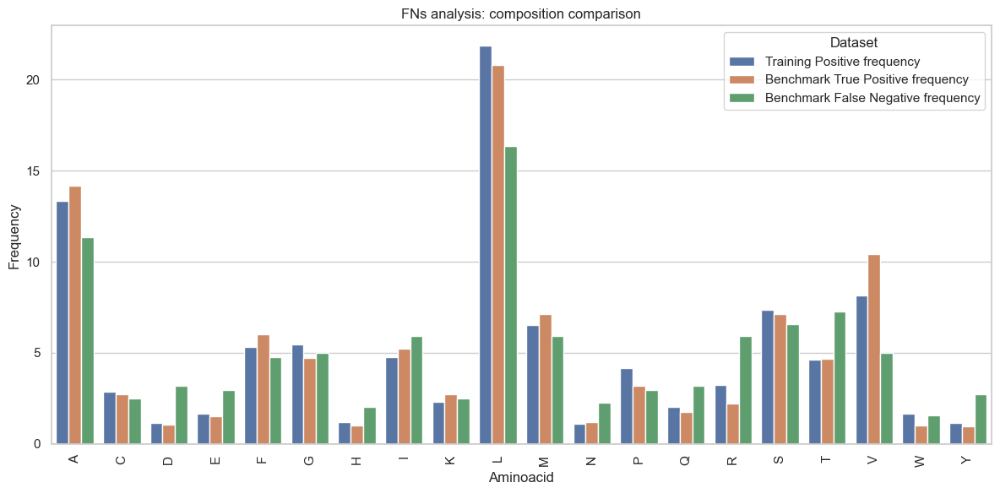

In [ ]:
# Trasformazione in formato long (melt)
last_frequency_df_long = last_frequency_df.reset_index().melt(id_vars='Aminoacid', 
                                                    var_name='Dataset', 
                                                    value_name='Frequency')

# Creazione del barplot con Seaborn
plt.figure(figsize=(12, 6))  # Definisci la dimensione della figura
sns.barplot(x='Aminoacid', y='Frequency', hue='Dataset', data=last_frequency_df_long)

# Miglioramenti grafici
plt.title("FNs analysis: composition comparison")
plt.xticks(rotation=90)  # Ruota le etichette degli aminoacidi per leggibilità
plt.tight_layout()  # Migliora il layout

# Mostra il grafico
plt.show()


### 7.4 Length distribution comparison of SP



In [ ]:
SP_TP_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "+"')["Cleavage"])
SP_FN_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "-"')["Cleavage"])
SP_pos_train_SVM = list(training_df.query('Type == "+"')["Cleavage"])

In [ ]:

SP_TP_SVM

[18.0,
 23.0,
 32.0,
 33.0,
 28.0,
 15.0,
 31.0,
 31.0,
 25.0,
 22.0,
 20.0,
 19.0,
 28.0,
 21.0,
 22.0,
 19.0,
 20.0,
 23.0,
 27.0,
 19.0,
 29.0,
 24.0,
 16.0,
 17.0,
 22.0,
 31.0,
 24.0,
 21.0,
 19.0,
 24.0,
 23.0,
 24.0,
 22.0,
 21.0,
 20.0,
 23.0,
 25.0,
 24.0,
 24.0,
 24.0,
 24.0,
 27.0,
 16.0,
 26.0,
 24.0,
 15.0,
 23.0,
 18.0,
 19.0,
 22.0,
 31.0,
 31.0,
 24.0,
 31.0,
 22.0,
 15.0,
 18.0,
 27.0,
 20.0,
 20.0,
 20.0,
 23.0,
 23.0,
 26.0,
 23.0,
 26.0,
 23.0,
 24.0,
 15.0,
 23.0,
 23.0,
 28.0,
 20.0,
 25.0,
 18.0,
 23.0,
 19.0,
 19.0,
 24.0,
 21.0,
 21.0,
 24.0,
 16.0,
 30.0,
 19.0,
 19.0,
 29.0,
 15.0,
 24.0,
 23.0,
 20.0,
 20.0,
 22.0,
 18.0,
 22.0,
 24.0,
 23.0,
 21.0,
 25.0,
 16.0,
 22.0,
 33.0,
 28.0,
 21.0,
 19.0,
 17.0,
 24.0,
 19.0,
 24.0,
 28.0,
 30.0,
 23.0,
 16.0,
 18.0,
 27.0,
 26.0,
 23.0,
 22.0,
 19.0,
 33.0,
 42.0,
 26.0,
 19.0,
 23.0,
 26.0,
 29.0,
 19.0,
 24.0,
 18.0,
 29.0,
 16.0,
 26.0,
 19.0,
 21.0,
 23.0,
 24.0,
 20.0,
 24.0,
 30.0,
 26.0,
 18.0,
 25.0,
 20.0,

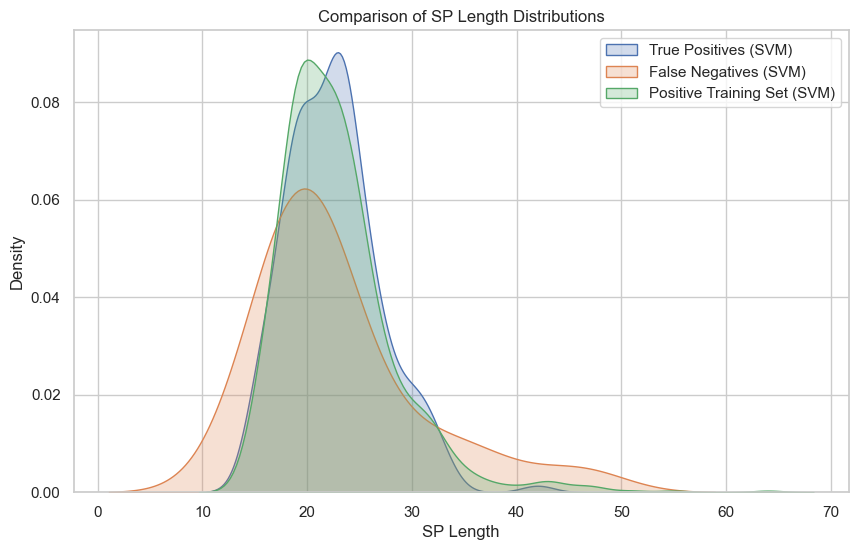

In [ ]:
# Set the figure size
plt.figure(figsize=(10, 6))

# Plot the distributions using seaborn KDE (smooth curves for the distributions)
sns.kdeplot(SP_TP_SVM, label="True Positives (SVM)", fill=True)
sns.kdeplot(SP_FN_SVM, label="False Negatives (SVM)", fill=True)
sns.kdeplot(SP_pos_train_SVM, label="Positive Training Set (SVM)", fill=True)

# Add labels and title
plt.xlabel('SP Length')
plt.ylabel('Density')
plt.title('Comparison of SP Length Distributions')
plt.legend()

# Show the plot
plt.show()

In [ ]:
prova_feature_Max_FN_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "-"')['Max_CH'])
print(prova_feature_Max_FN_SVM)

[0.6666666666666666, 1.0, 1.0, 1.0, 0.6666666666666666, 0.6666666666666666, 0.3333333333333333, 0.3333333333333333, 0.6666666666666666, 1.0, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.3333333333333333, 0.3333333333333333, 1.0, 0.3333333333333333, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666]


In [ ]:
print(list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "+"')['Max_CH']))


[0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.3333333333333333, 0.3333333333333333, 0.6666666666666666, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.6666666666666666, 0.3333333333333333, 0.6666666666666666, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.6666666666666666, 0.3333333333333333, 0.3333333333333333, 0.6666666666666666, 0.3333333333333333, 0.6666666666666666, 0.3333333333333333, 0.6666666666666666, 0.3333333333333333, 1.0, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.6666666666666666, 0.3333333333333333, 0.3333333333333333, 0.6666666666666666, 0.6666666666666666, 0.6666666666666666, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.6666666666666666, 0.6666666666666666, 0.3333333333333333, 0.3333333333333333, 0.6666666666666666, 1.0, 0.6666666

In [ ]:
def compare_features(feature):
    if feature == 'CH': 
        feature_Max_TP_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "+"')['Max_%s' %feature])
        feature_Norm_TP_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "+"')['Norm_%s' %feature])
        feature_Max_FN_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "-"')['Max_%s' %feature])
        feature_Norm_FN_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "-"')['Norm_%s' %feature])
        
            # Prepare the data for boxplot
        data = {
            'Feature Type': ['Max'] * len(feature_Max_TP_SVM) + ['Norm'] * len(feature_Norm_TP_SVM) +
                            ['Max'] * len(feature_Max_FN_SVM) + ['Norm'] * len(feature_Norm_FN_SVM),
            'True/False': ['True Positive'] * len(feature_Max_TP_SVM) + ['True Positive'] * len(feature_Norm_TP_SVM) +
                        ['False Negative'] * len(feature_Max_FN_SVM) + ['False Negative'] * len(feature_Norm_FN_SVM),
            'Value': feature_Max_TP_SVM + feature_Norm_TP_SVM + feature_Max_FN_SVM + feature_Norm_FN_SVM
        }

        # Create a DataFrame
        df = pd.DataFrame(data)

        # Create the boxplot using seaborn
        sns.set(style="whitegrid", context="notebook")

        # Create the boxplot
        plt.figure(figsize=(12, 8))
        sns.boxplot(x='Feature Type', y='Value', hue='True/False', data=df,
                    palette="Set2", linewidth=1.5)

        # Add labels and title with enhanced font sizes
        plt.xlabel('Feature Type', fontsize=14)
        plt.ylabel('Feature Value', fontsize=14)
        plt.title(f'Comparison of Max and Avg {feature} Distribution between True Positives vs False Negatives', fontsize=16)
        plt.legend(title='Category', fontsize=12, title_fontsize='13')

        # Show the plot
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()  # Adjust layout to make room for the title
        plt.show()

        # Show the plot
        plt.show()
        
    else:
        feature_Max_TP_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "+"')['Max_%s' %feature])
        feature_Avg_TP_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "+"')['Avg_%s' %feature])
        feature_Max_FN_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "-"')['Max_%s' %feature])
        feature_Avg_FN_SVM = list(results_benchmark_SVM_df.query('Type_SVM == "+" and Prediction_SVM == "-"')['Avg_%s' %feature])

    # Prepare the data for boxplot
        data = {
            'Feature Type': ['Max'] * len(feature_Max_TP_SVM) + ['Avg'] * len(feature_Avg_TP_SVM) +
                            ['Max'] * len(feature_Max_FN_SVM) + ['Avg'] * len(feature_Avg_FN_SVM),
            'True/False': ['True Positive'] * len(feature_Max_TP_SVM) + ['True Positive'] * len(feature_Avg_TP_SVM) +
                        ['False Negative'] * len(feature_Max_FN_SVM) + ['False Negative'] * len(feature_Avg_FN_SVM),
            'Value': feature_Max_TP_SVM + feature_Avg_TP_SVM + feature_Max_FN_SVM + feature_Avg_FN_SVM
        }

        # Create a DataFrame
        df = pd.DataFrame(data)

        sns.set(style="whitegrid", context="notebook")

        # Create the boxplot
        plt.figure(figsize=(12, 8))
        sns.boxplot(x='Feature Type', y='Value', hue='True/False', data=df,
                    palette="Set2", linewidth=1.5)

        # Add labels and title with enhanced font sizes
        plt.xlabel('Feature Type', fontsize=14)
        plt.ylabel('Feature Value', fontsize=14)
        plt.title(f'Comparison of Max and Avg {feature} Distribution between True Positives vs False Negatives', fontsize=16)
        plt.legend(title='Category', fontsize=12, title_fontsize='13')

        # Show the plot
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()  # Adjust layout to make room for the title
        plt.show()


In [ ]:
best_result["Best encoding Combination"].split(", ")

['AA', 'CH', 'TM']

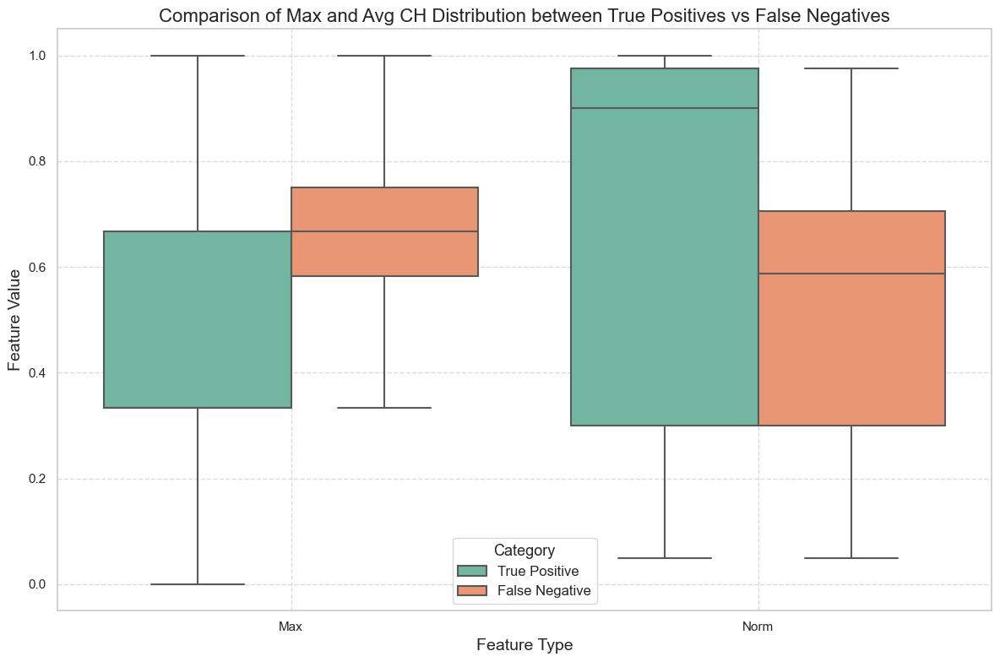

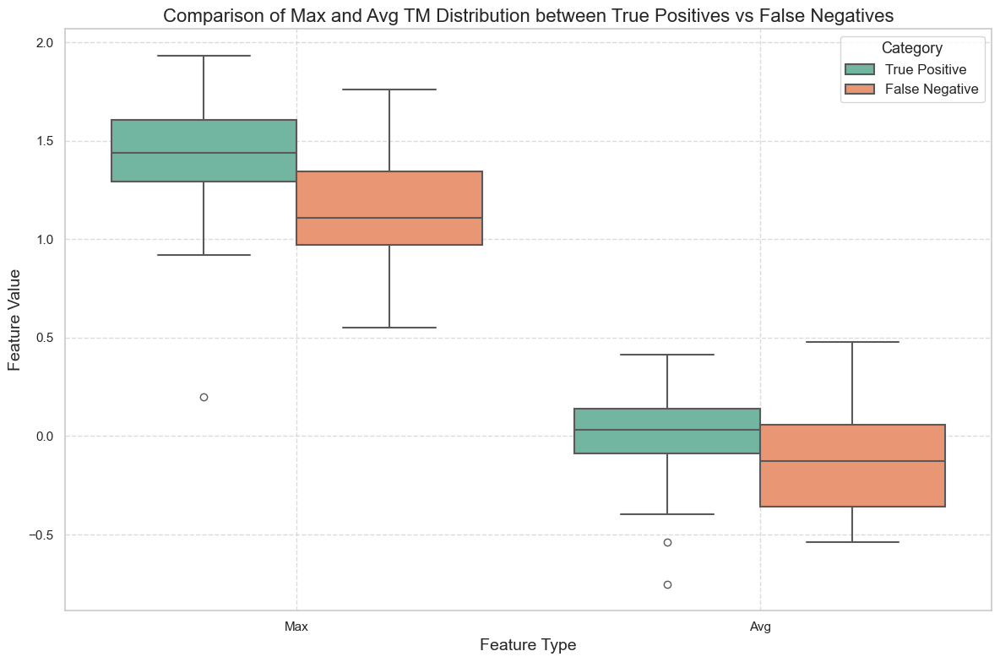

In [ ]:
for el in best_result["Best encoding Combination"].split(", ")[1:]:
    compare_features(el)
